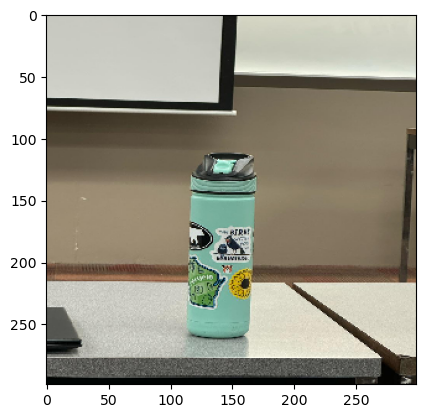

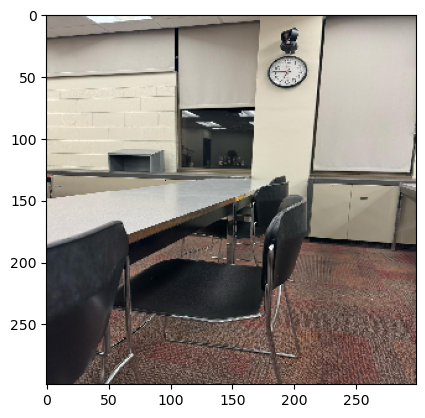

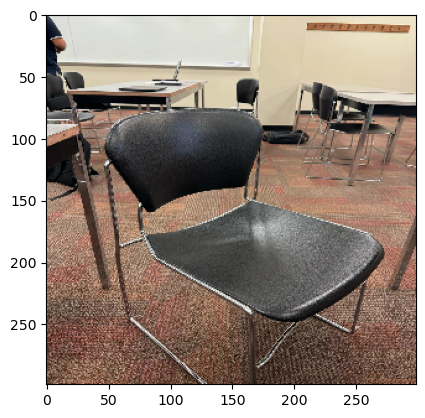

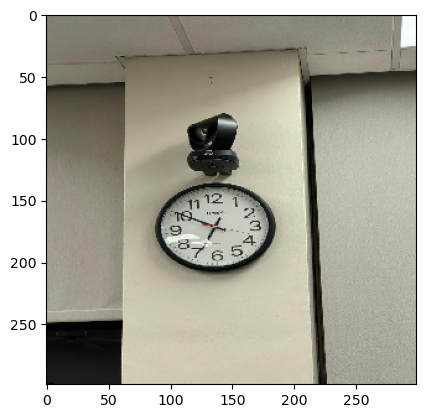

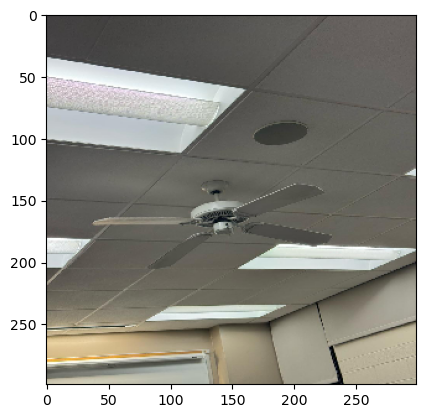

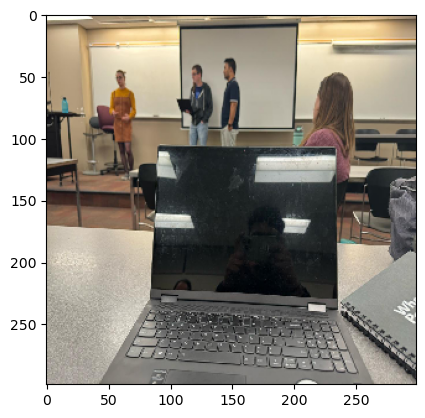

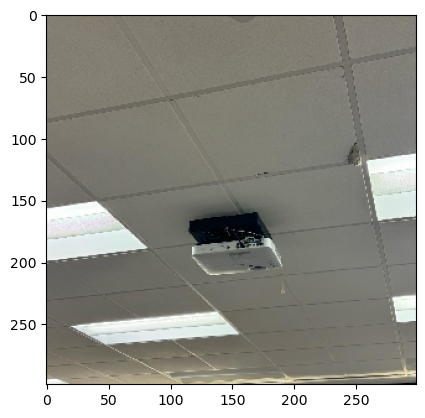

In [1]:
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.applications.inception_v3 import preprocess_input
import numpy as np
import os
from lime import lime_image
from keras.applications import inception_v3 as inc_net
from keras.applications.imagenet_utils import decode_predictions
from skimage.io import imread
import matplotlib.pyplot as plt
%matplotlib inline

inet_model = inc_net.InceptionV3()

explainer = lime_image.LimeImageExplainer()

image_dir = './LIME_Images/'

images_dict = {}
for img_name in os.listdir(image_dir):
    img_path = os.path.join(image_dir, img_name)
    img = load_img(img_path, target_size=(299, 299))
    images_dict[img_name] = img
    plt.imshow(img)
    plt.show()

<br></br>
<h1>Predictions and their confidences before cropping the images:</h1>

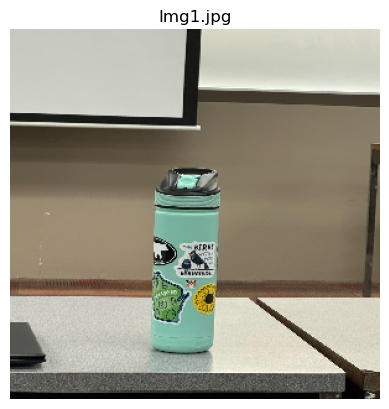

1/1 [==============================] - 3s 3s/step
Top 5 predictions:
1: water_bottle with confidence 0.58
2: water_jug with confidence 0.07
3: home_theater with confidence 0.02
4: ashcan with confidence 0.01
5: lighter with confidence 0.01




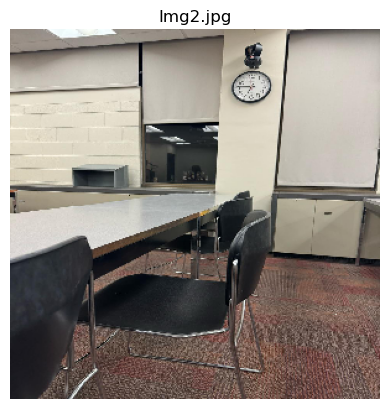

1/1 [==============================] - 0s 215ms/step
Top 5 predictions:
1: wall_clock with confidence 0.55
2: dining_table with confidence 0.27
3: desk with confidence 0.04
4: analog_clock with confidence 0.02
5: folding_chair with confidence 0.01




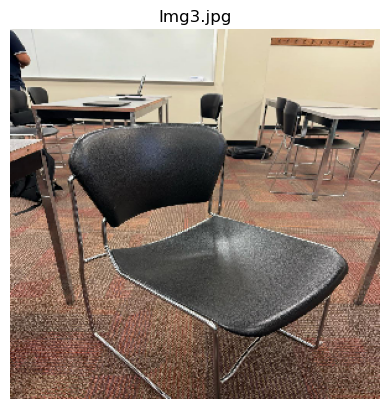

1/1 [==============================] - 0s 213ms/step
Top 5 predictions:
1: folding_chair with confidence 0.56
2: dining_table with confidence 0.01
3: library with confidence 0.01
4: file with confidence 0.01
5: patio with confidence 0.01




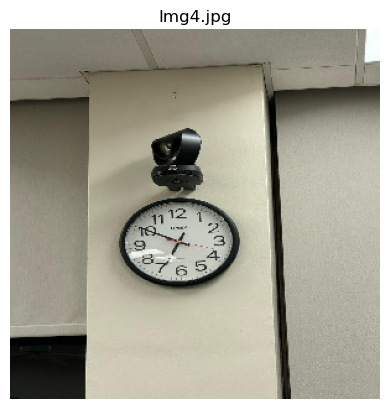

1/1 [==============================] - 0s 206ms/step
Top 5 predictions:
1: analog_clock with confidence 0.37
2: stopwatch with confidence 0.32
3: wall_clock with confidence 0.15
4: digital_watch with confidence 0.00
5: barometer with confidence 0.00




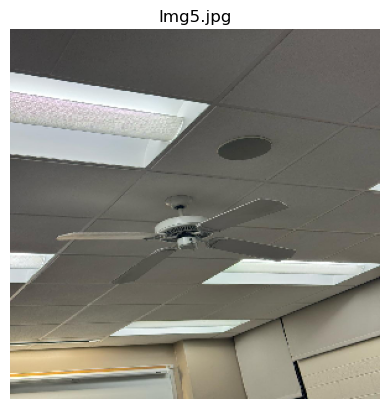

1/1 [==============================] - 0s 212ms/step
Top 5 predictions:
1: spotlight with confidence 0.12
2: projector with confidence 0.10
3: solar_dish with confidence 0.08
4: electric_fan with confidence 0.08
5: cinema with confidence 0.06




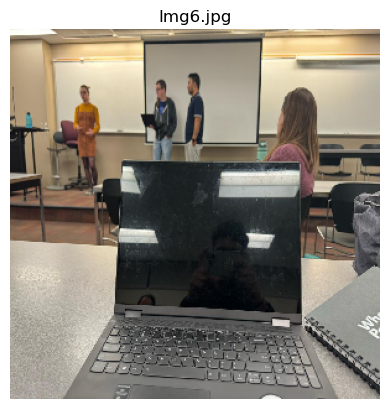

1/1 [==============================] - 0s 197ms/step
Top 5 predictions:
1: notebook with confidence 0.51
2: laptop with confidence 0.40
3: desktop_computer with confidence 0.00
4: monitor with confidence 0.00
5: mouse with confidence 0.00




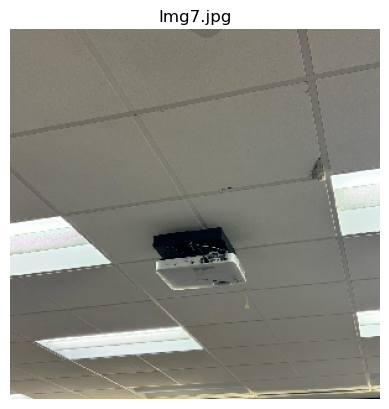

1/1 [==============================] - 0s 198ms/step
Top 5 predictions:
1: projector with confidence 0.99
2: horizontal_bar with confidence 0.00
3: spotlight with confidence 0.00
4: washbasin with confidence 0.00
5: airship with confidence 0.00




In [2]:
for image_name, img in sorted(images_dict.items()):
#     img_path = os.path.join(image_dir, img_name)
#     img = load_img(img_path, target_size=(299, 299))
    plt.imshow(img)
    plt.title(image_name)
    plt.axis('off')  
    plt.show()
    
    x = img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)
    
    preds = inet_model.predict(x)
    
    decoded_preds = decode_predictions(preds, top=5)[0]
    
    print(f"Top 5 predictions:")
    for i, (imagenet_id, name, score) in enumerate(decoded_preds):
        print(f"{i+1}: {name} with confidence {score:.2f}")
    print("\n")

<br></br>
<h2>Result 1</h2>

**Discussion:** Before Cropping I'm displaying top 5 predictions for the image with the confidence level of that prediction. The top prediction may not be correct for every image and with the lower confidences. Because the images has different other things and model taking them into consideration as well. Like for example, in the "img2" it has a chair and a analog clock/wall clock etc., in the back so it kind of taking them into consideration and giving the predictions with the confidence levels.

<br></br>
<h1>Predictions and their confidences after cropping the images:</h1>

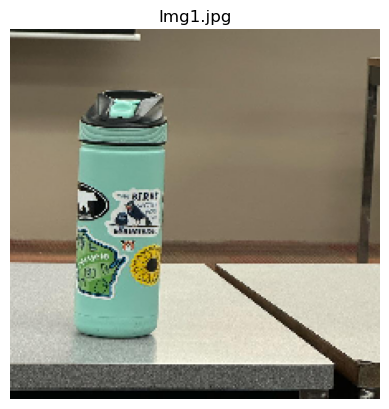

1/1 [==============================] - 0s 141ms/step
Top 5 predictions:
1: water_bottle with confidence 1.00
2: water_jug with confidence 0.00
3: lighter with confidence 0.00
4: cocktail_shaker with confidence 0.00
5: hair_spray with confidence 0.00




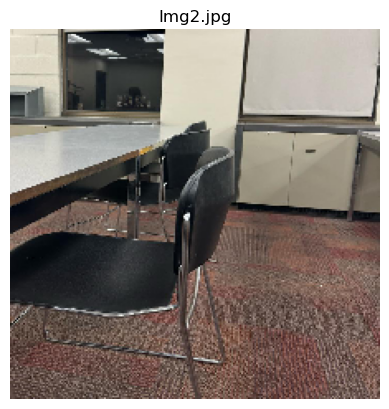

1/1 [==============================] - 0s 131ms/step
Top 5 predictions:
1: dining_table with confidence 0.90
2: pool_table with confidence 0.05
3: desk with confidence 0.05
4: guillotine with confidence 0.00
5: restaurant with confidence 0.00




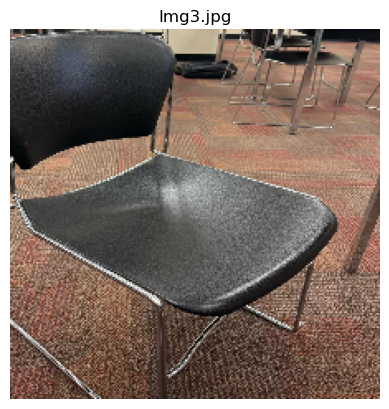

1/1 [==============================] - 0s 138ms/step
Top 5 predictions:
1: folding_chair with confidence 0.94
2: patio with confidence 0.05
3: dining_table with confidence 0.00
4: restaurant with confidence 0.00
5: barber_chair with confidence 0.00




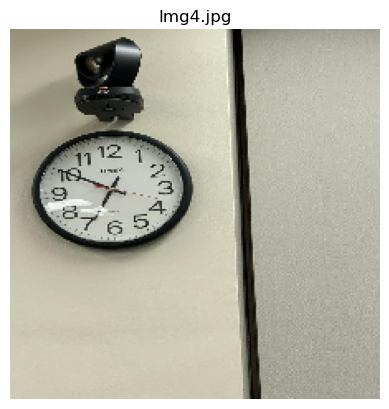

1/1 [==============================] - 0s 141ms/step
Top 5 predictions:
1: analog_clock with confidence 0.92
2: wall_clock with confidence 0.06
3: stopwatch with confidence 0.01
4: barometer with confidence 0.00
5: mortarboard with confidence 0.00




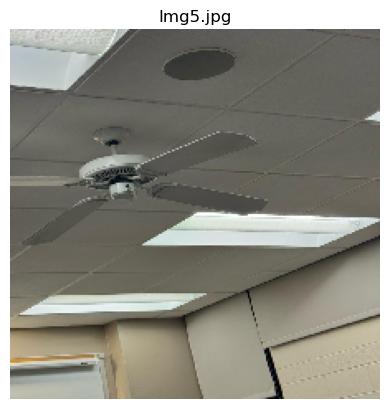

1/1 [==============================] - 0s 122ms/step
Top 5 predictions:
1: electric_fan with confidence 0.58
2: radio_telescope with confidence 0.15
3: solar_dish with confidence 0.06
4: warplane with confidence 0.06
5: projectile with confidence 0.05




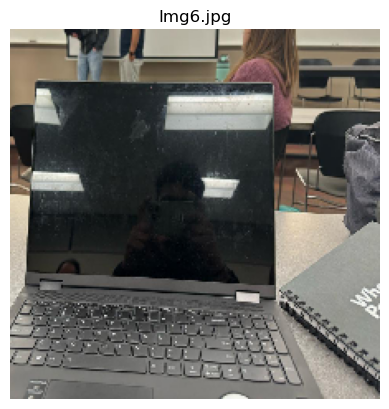

1/1 [==============================] - 0s 143ms/step
Top 5 predictions:
1: laptop with confidence 0.98
2: notebook with confidence 0.00
3: printer with confidence 0.00
4: desk with confidence 0.00
5: desktop_computer with confidence 0.00




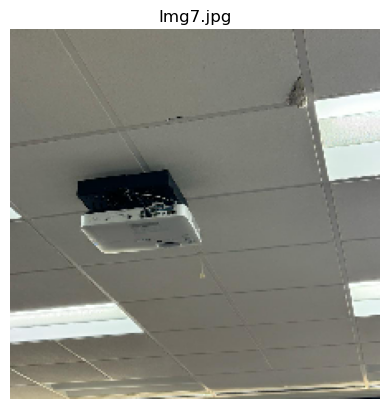

1/1 [==============================] - 0s 147ms/step
Top 5 predictions:
1: projector with confidence 0.66
2: scale with confidence 0.04
3: sewing_machine with confidence 0.03
4: swing with confidence 0.02
5: prison with confidence 0.01




In [15]:
processed_images_for_Lime = {}

for image_name, img in sorted(images_dict.items()):
    width, height = img.size
    cropped_img = img.crop((width/4, height/4, 4*width/4, 4*height/4))
    plt.imshow(cropped_img)
    plt.title(image_name)
    plt.axis('off')
    plt.show()

    x = img_to_array(cropped_img)
    x = np.expand_dims(x, axis=0)
    x = inc_net.preprocess_input(x)
    
    preds = inet_model.predict(x)

    decoded_preds = decode_predictions(preds, top=5)[0]
    
    print(f"Top 5 predictions:")
    for i, (imagenet_id, name, score) in enumerate(decoded_preds):
        print(f"{i+1}: {name} with confidence {score:.2f}")
    print("\n")
    processed_images_for_Lime[image_name] = x

<br></br>
<h2>Result 2</h2>

**Discussion:** After Cropping the images the predictions have been changes with increased confidence levels. "The water bottle" with 100% confidence, "folding chair" with 94%, "Analog clock" with 92%, "Electric fan" raced to the top from 4th place which previously has only 0.08(8%) confidence level to the 0.58(58%) confidence, and "laptop" with 98%. But in contrast the confidence level of projector has dropped to 66% from 99%.

<br></br>
<h2>Obtaining Explanations Using Lime</h2>

In [4]:
import lime
from lime import lime_image

In [5]:
explainer = lime_image.LimeImageExplainer()

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 1s 640ms/step
[898, 899, 626, 503, 585]


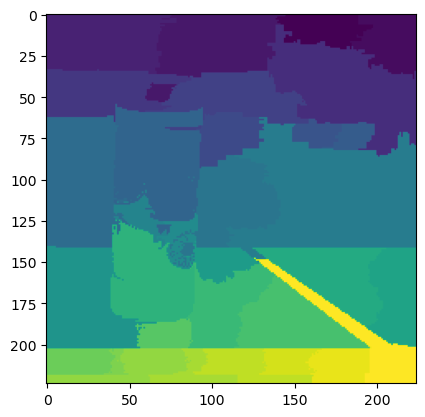

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(224, 224, 3) (224, 224)


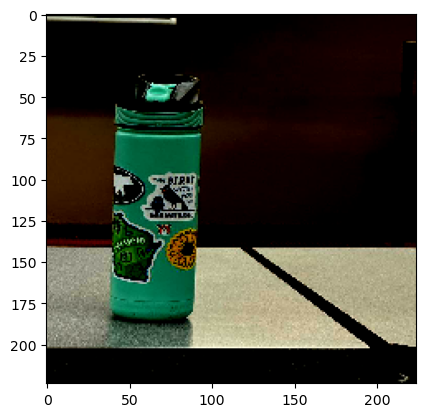

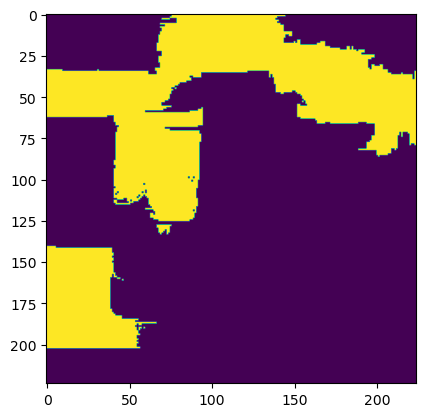

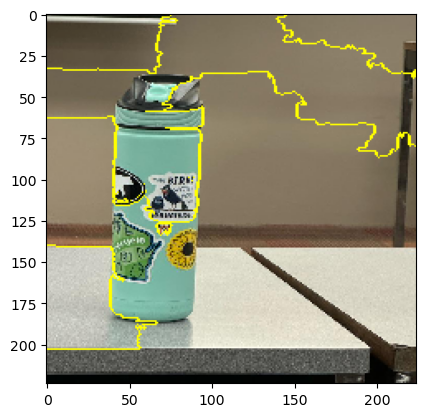

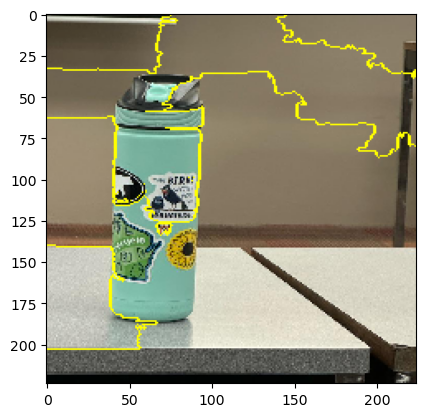

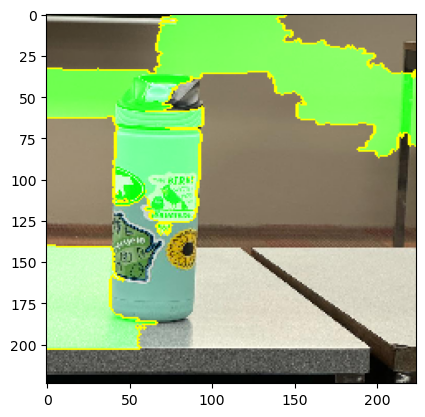

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 1s 615ms/step
[532, 736, 526, 583, 762]


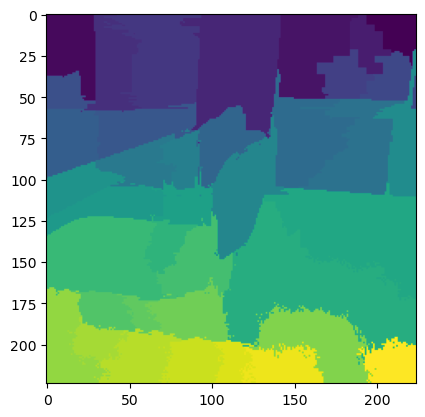

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(224, 224, 3) (224, 224)


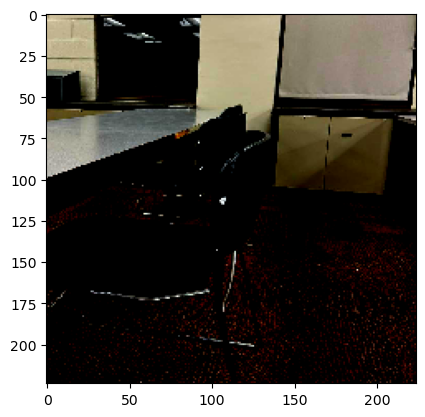

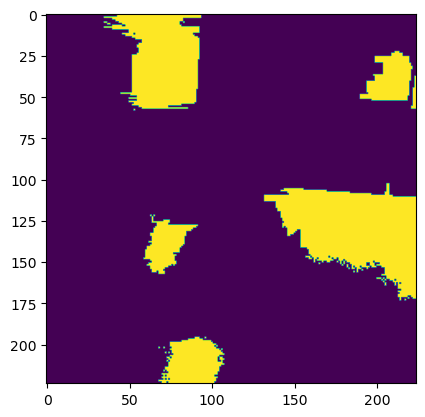

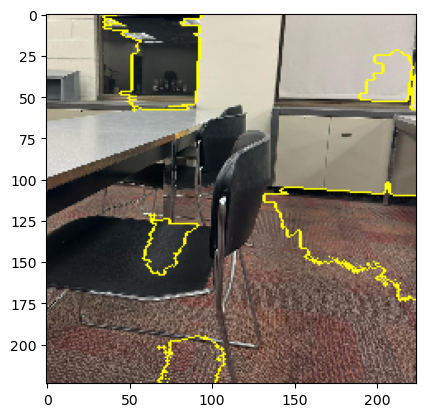

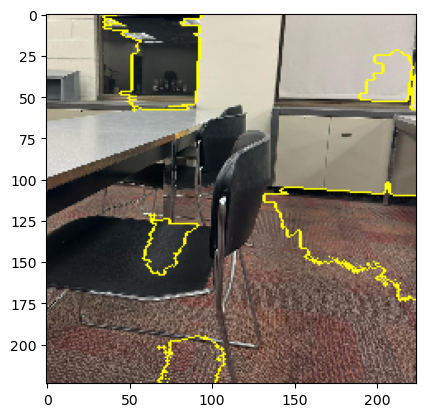

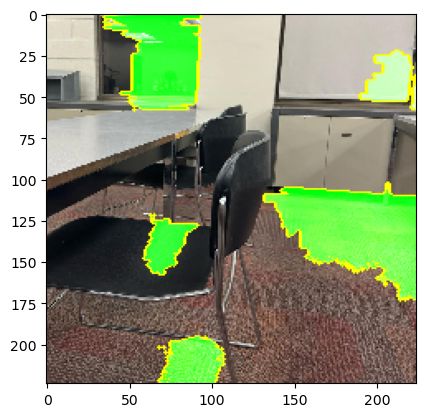

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 1s 643ms/step
[559, 706, 532, 762, 423]


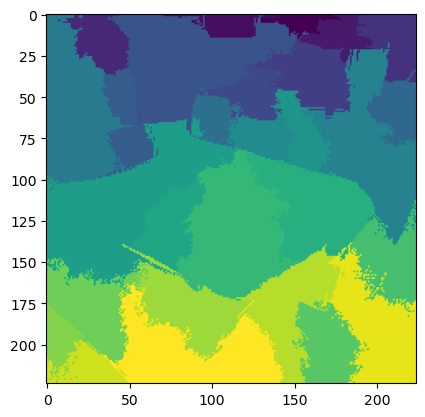

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(224, 224, 3) (224, 224)


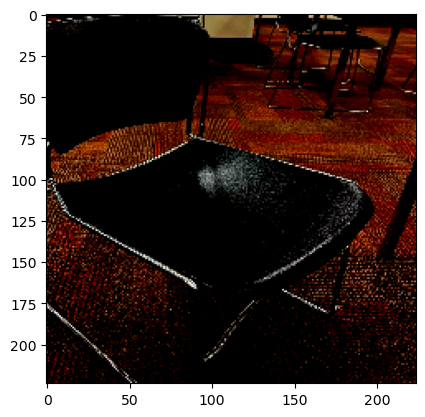

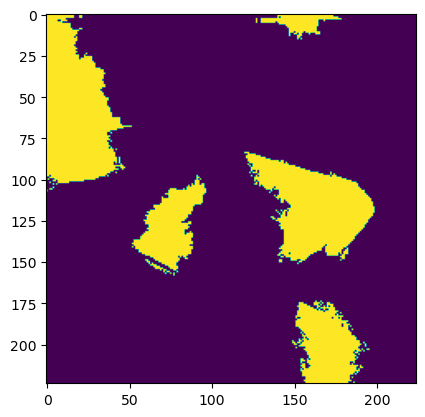

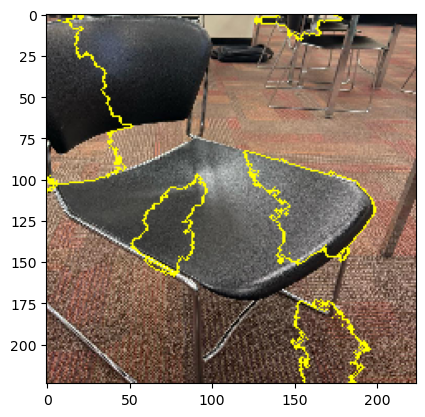

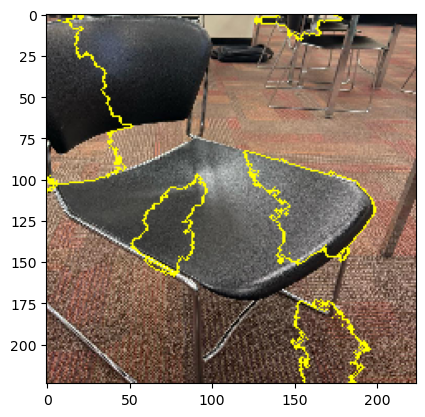

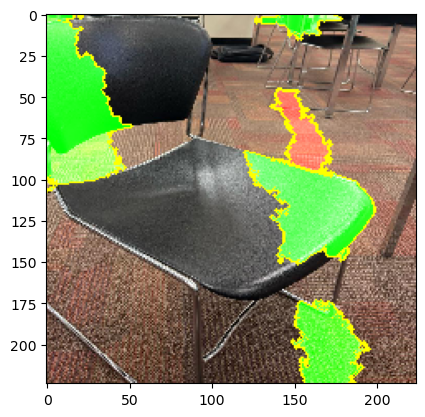

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 1s 644ms/step
[409, 892, 826, 426, 667]


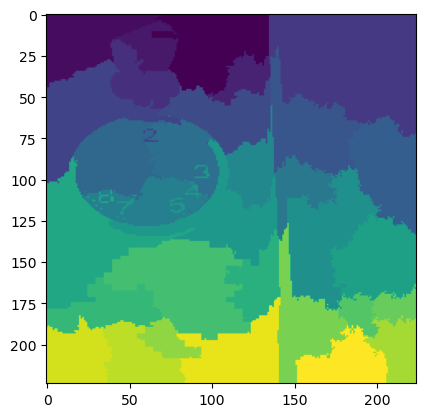

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(224, 224, 3) (224, 224)


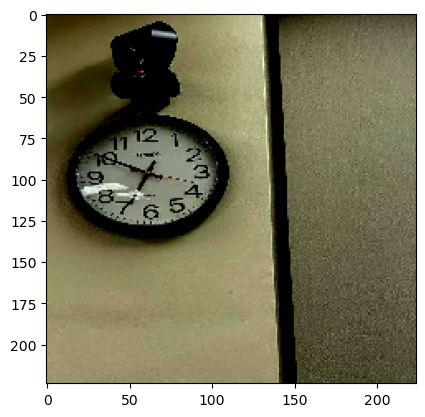

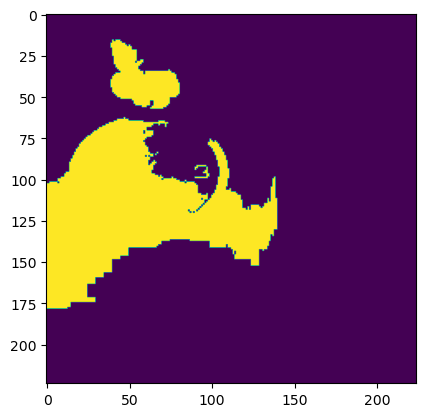

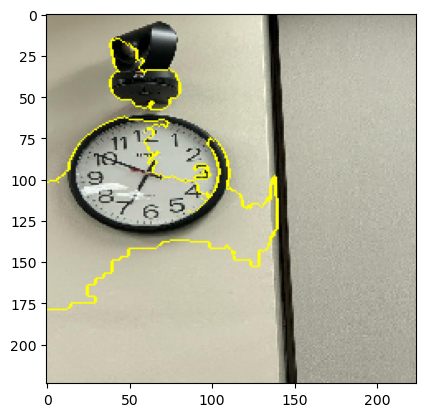

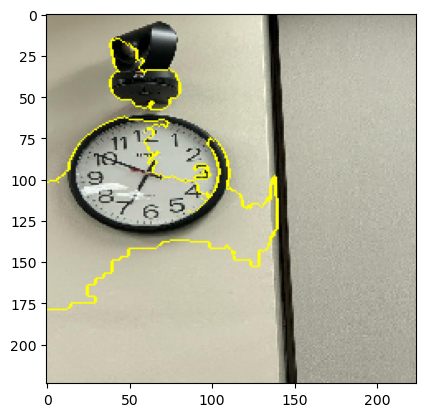

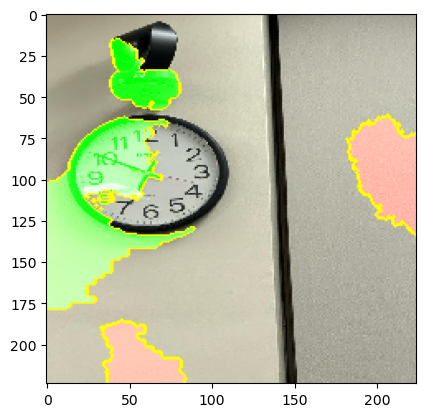

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 1s 964ms/step
[545, 755, 807, 895, 744]


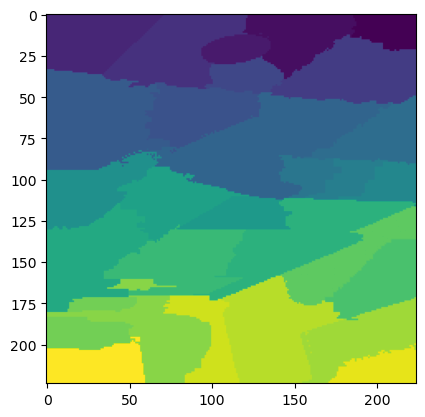

(224, 224, 3) (224, 224)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


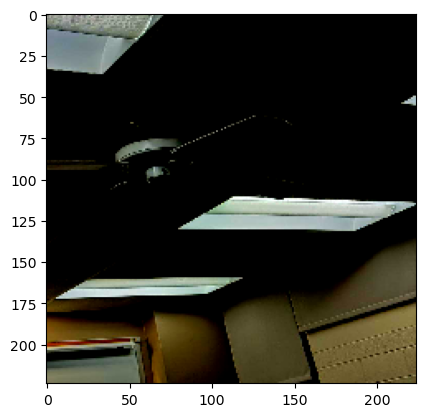

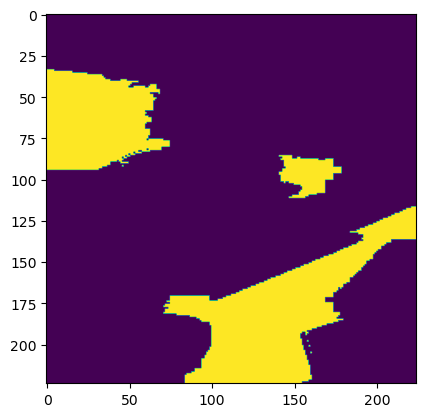

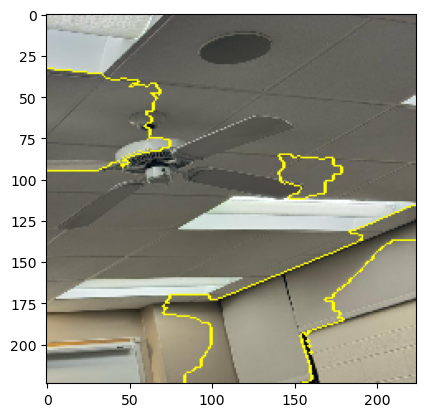

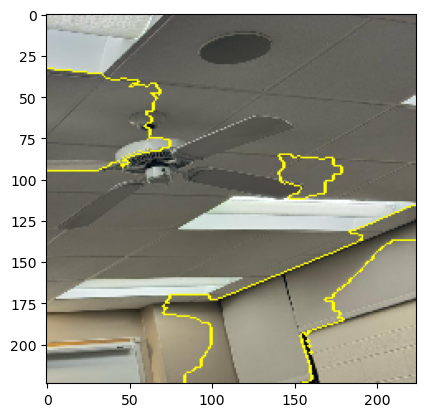

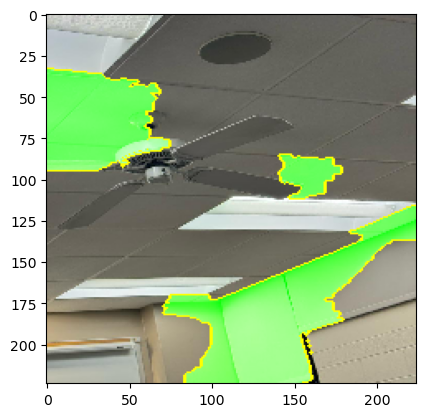

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 1s 745ms/step
[620, 681, 742, 526, 527]


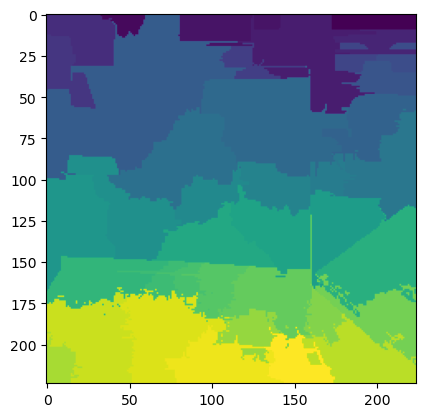

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(224, 224, 3) (224, 224)


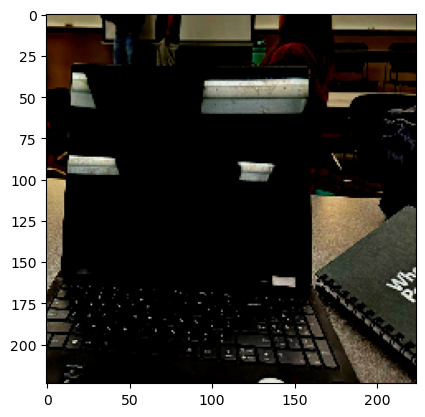

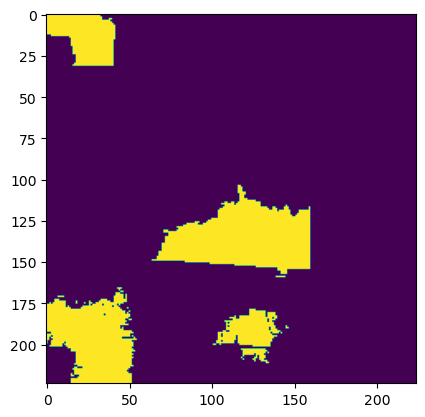

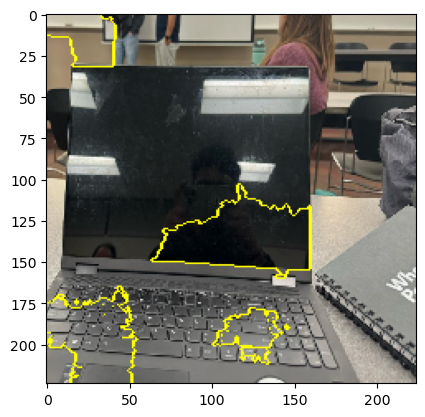

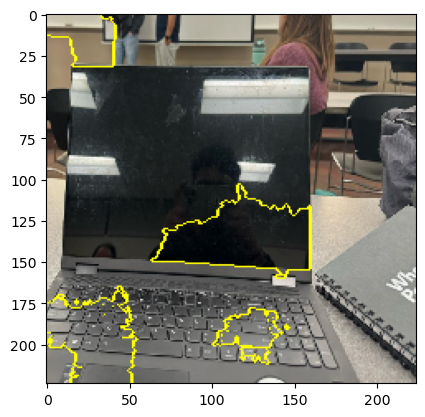

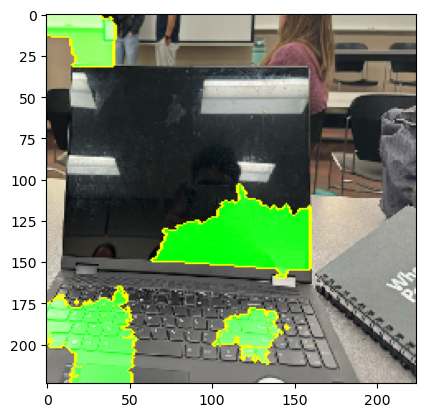

  0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 1s 892ms/step
[745, 778, 786, 843, 743]


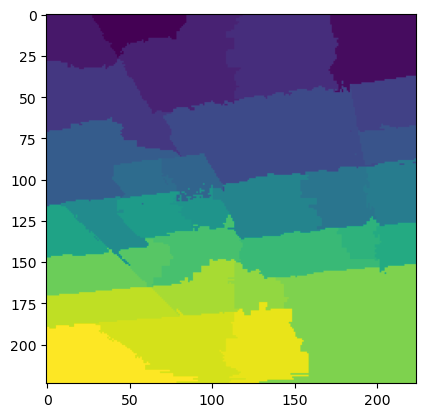

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(224, 224, 3) (224, 224)


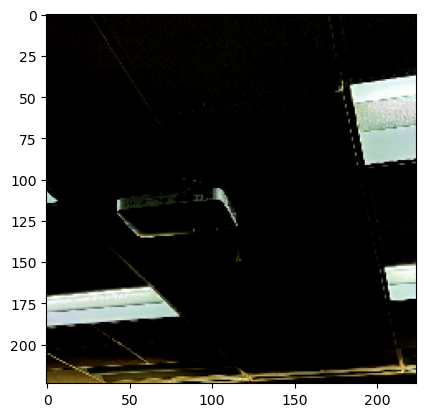

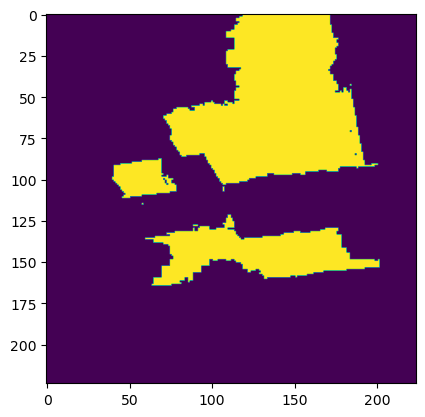

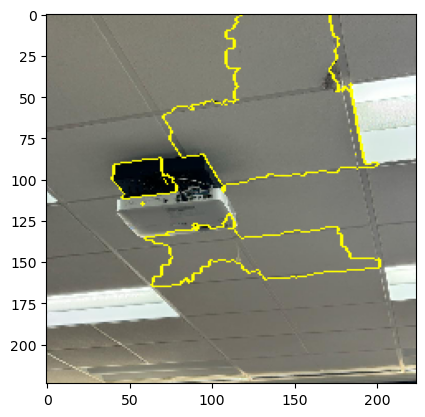

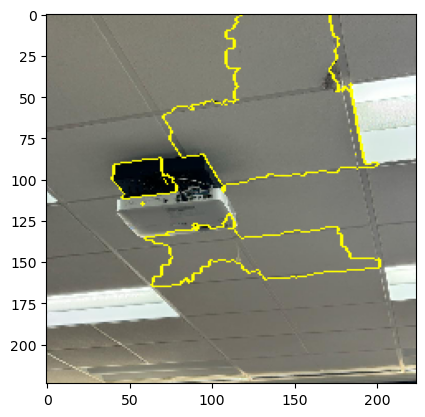

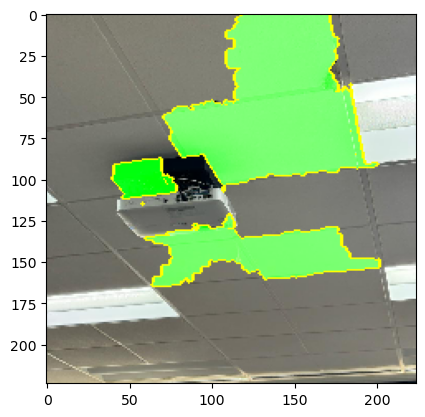

Wall time: 1min 27s


In [6]:
%%time
from skimage.segmentation import mark_boundaries
 
for image_name, x in processed_images_for_Lime.items():
    explanation = explainer.explain_instance(x[0].astype('double'), inet_model.predict, top_labels = 5, hide_color = 0, num_samples = 100)
    print(explanation.top_labels)
    plt.imshow(explanation.segments)
    plt.show()
    label = explanation.top_labels[0]
    
    a = explanation.get_image_and_mask(label=label)
    print(a[0].shape, a[1].shape)
    plt.imshow(a[0])
    plt.show()
    plt.imshow(a[1])
    plt.show()
    
    output_image = a[0]
    output_mask = a[1]
    plt.imshow(mark_boundaries(output_image/2+0.5, output_mask))
    plt.show()
    
    temp, mask = explanation.get_image_and_mask(label, positive_only =True, num_features =5, hide_rest = False)
    plt.imshow(mark_boundaries(temp/2+0.5, mask))
    plt.show()
    
    temp, mask = explanation.get_image_and_mask(label, positive_only =False, num_features =5, hide_rest = False)
    plt.imshow(mark_boundaries(temp/2+0.5, mask))
    plt.show()

<br></br>
<h2>Changing the Samples</h2>

  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 684ms/step
[898, 899, 626, 503, 585]


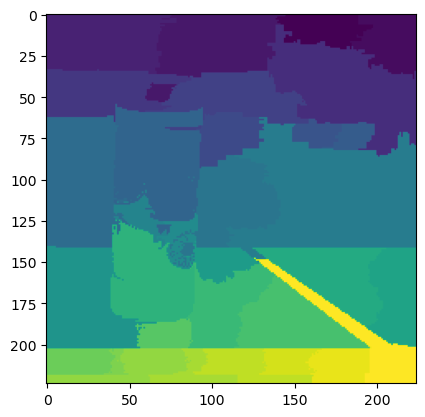

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(224, 224, 3) (224, 224)


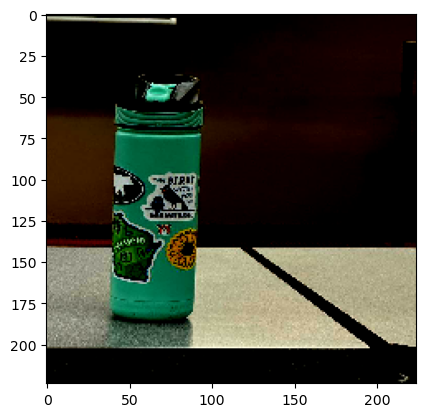

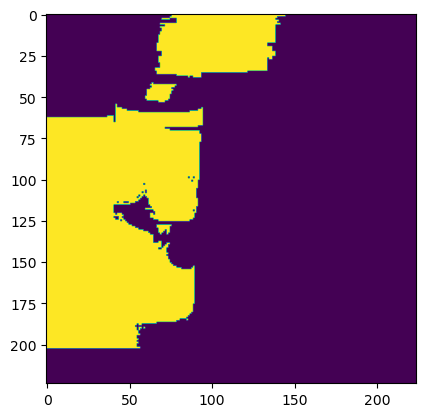

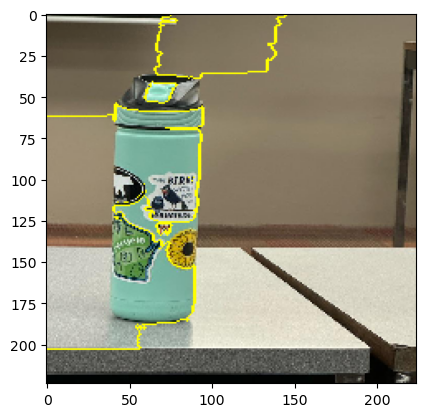

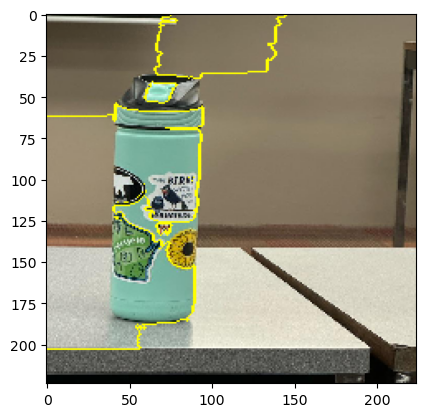

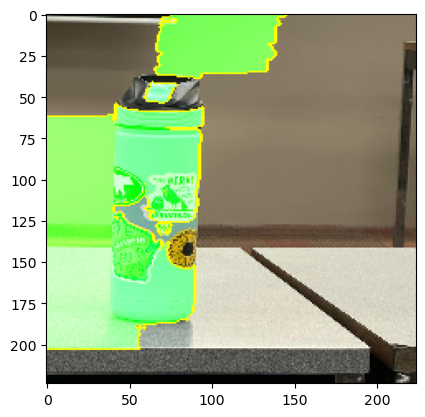

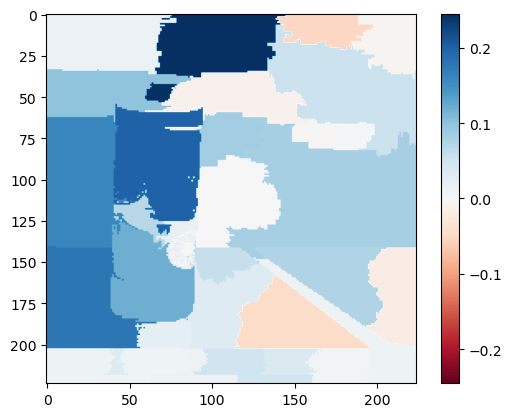

  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 850ms/step
[532, 736, 526, 583, 762]


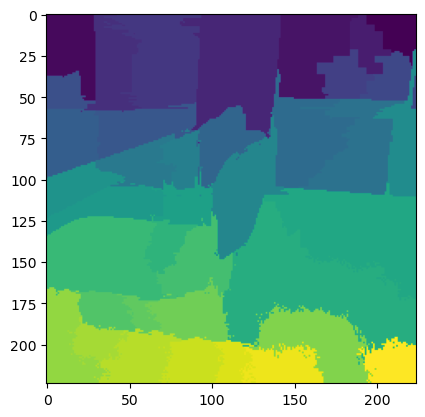

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(224, 224, 3) (224, 224)


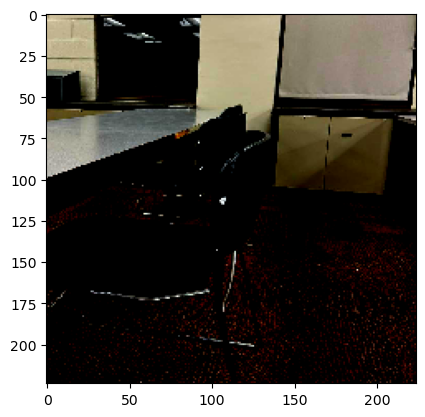

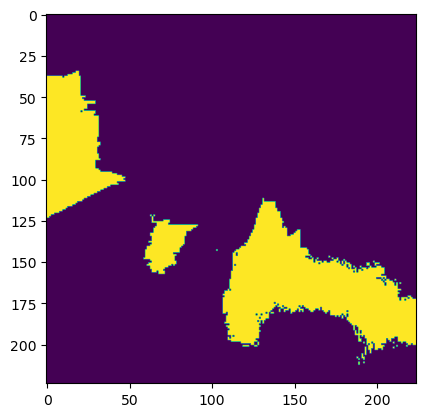

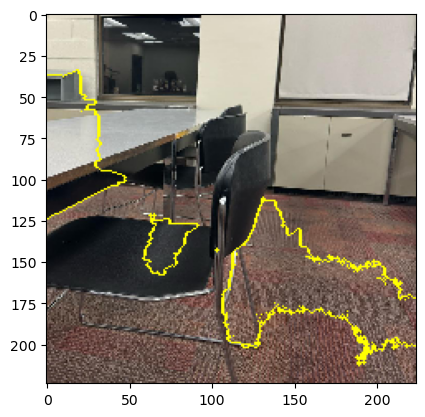

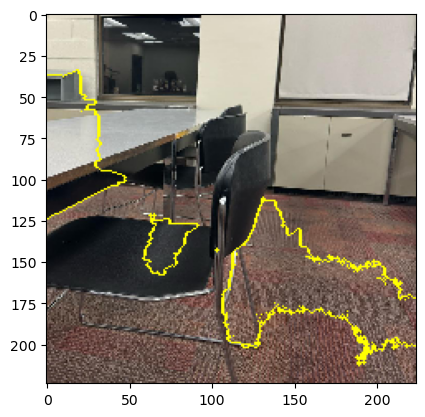

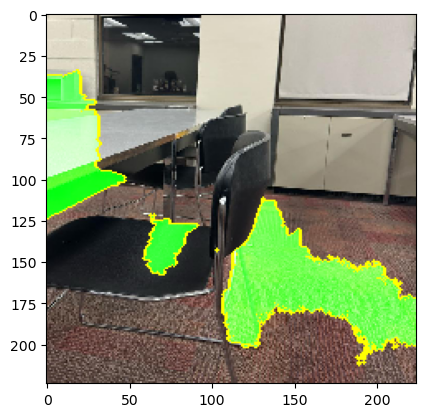

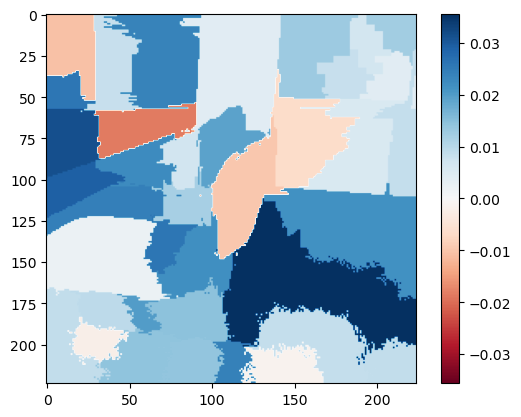

  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 690ms/step
[559, 706, 532, 762, 423]


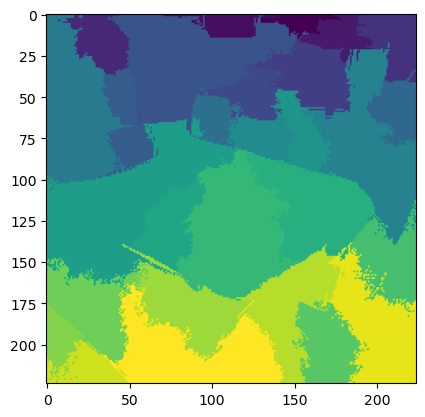

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(224, 224, 3) (224, 224)


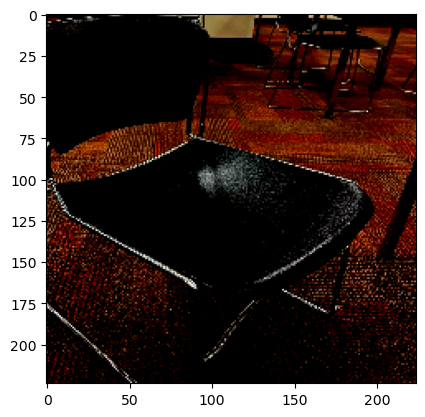

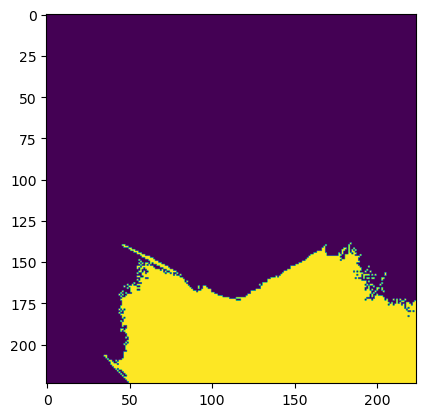

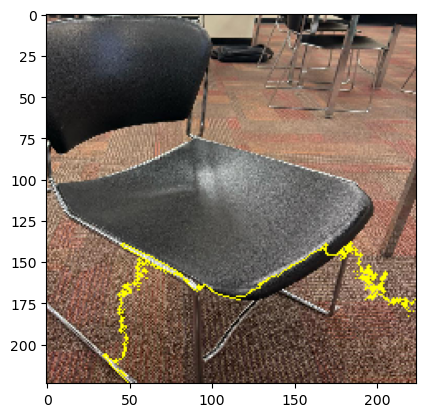

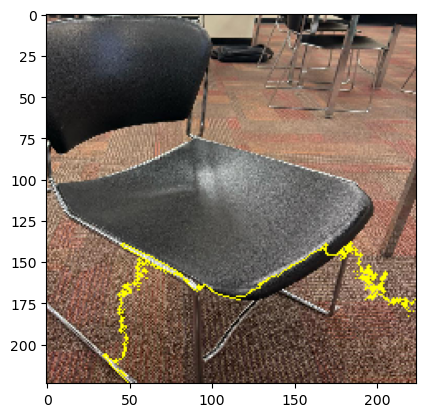

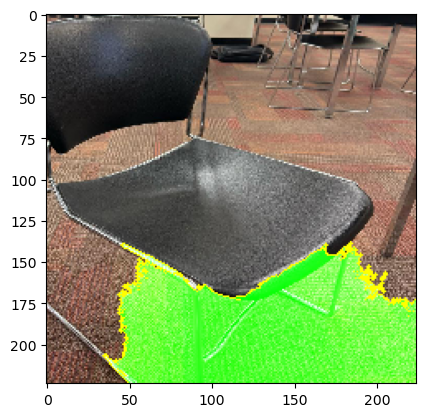

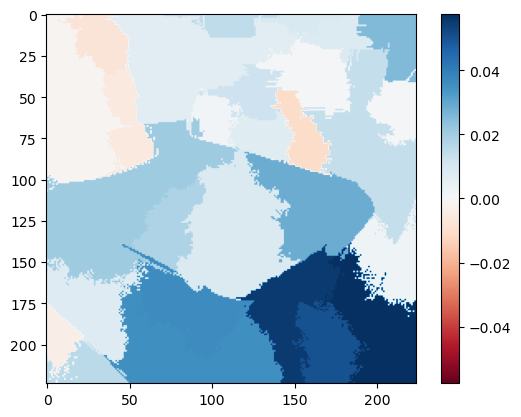

  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 678ms/step
[409, 892, 826, 426, 667]


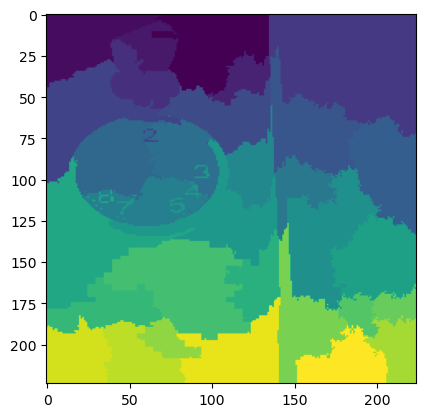

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(224, 224, 3) (224, 224)


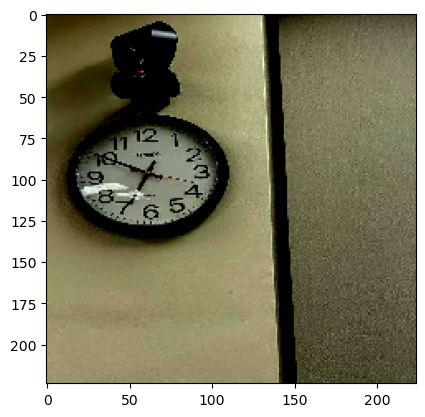

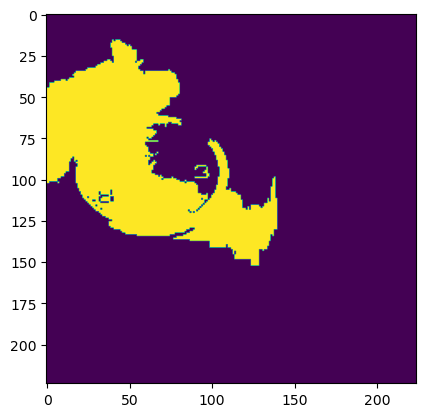

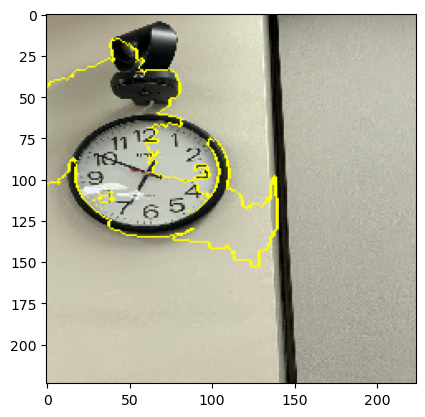

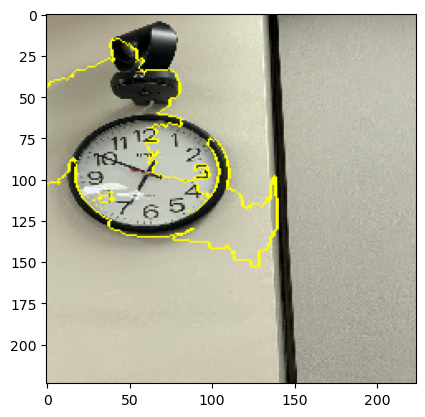

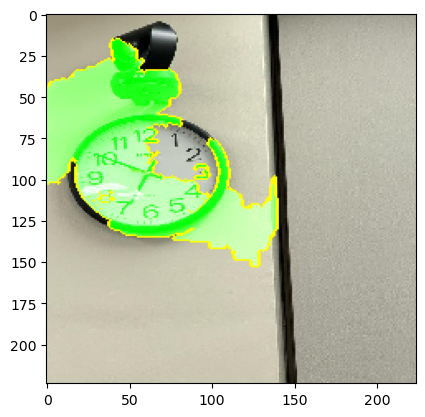

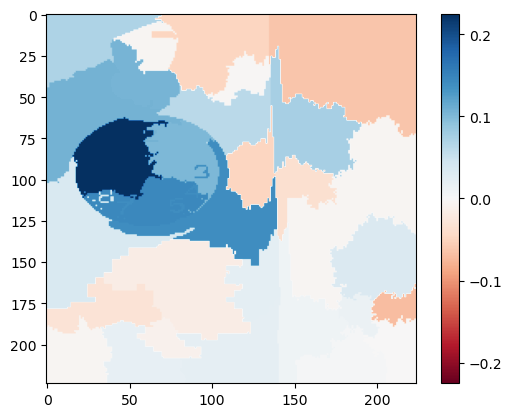

  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 778ms/step
[545, 755, 807, 895, 744]


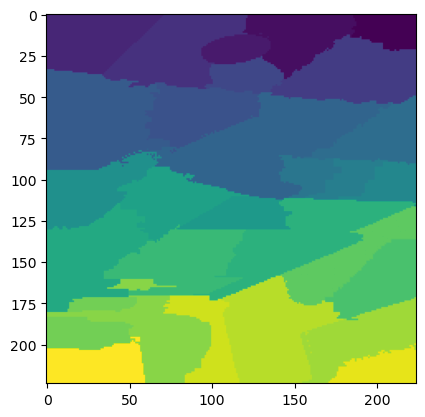

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(224, 224, 3) (224, 224)


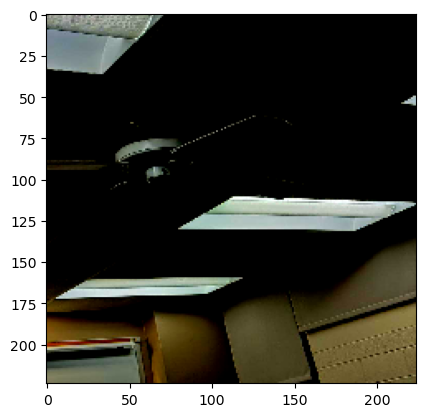

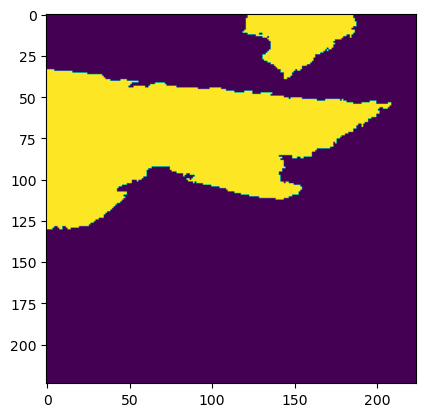

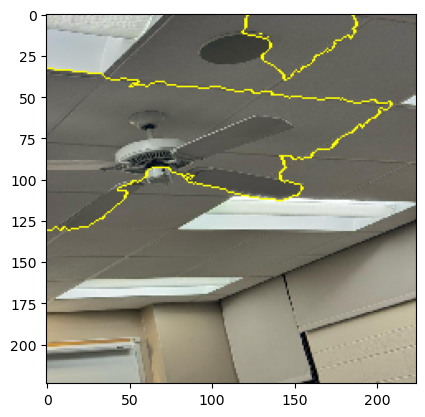

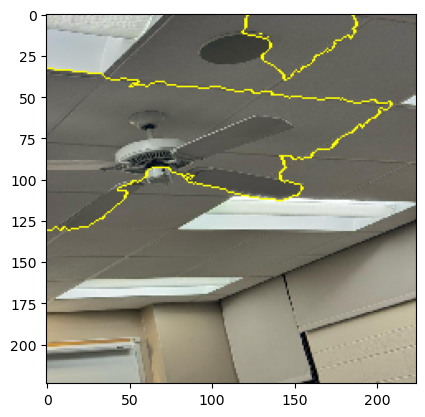

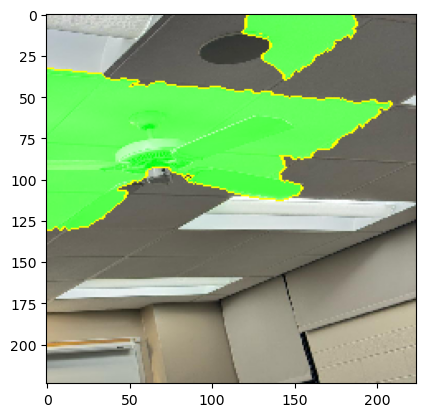

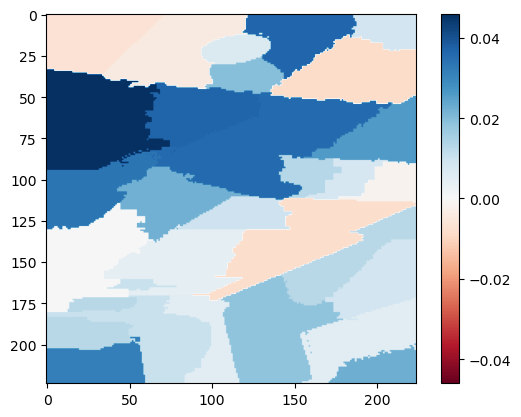

  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 673ms/step
[620, 681, 742, 526, 527]


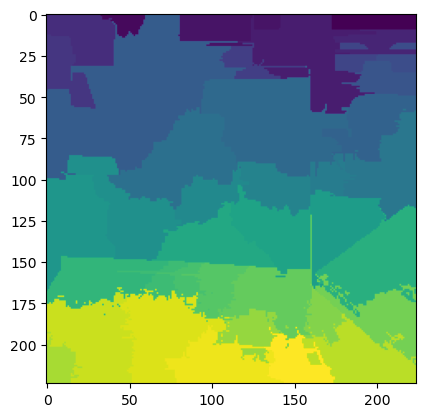

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(224, 224, 3) (224, 224)


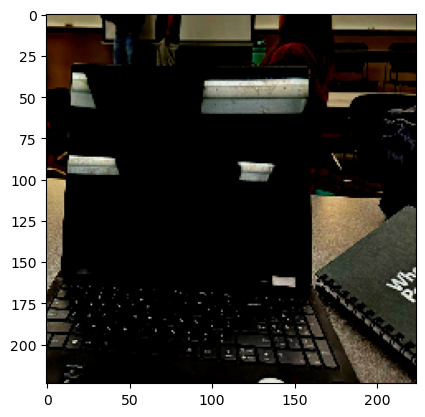

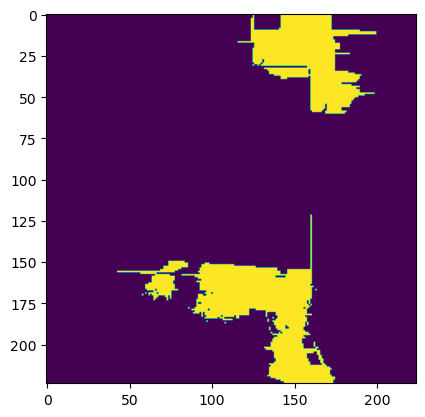

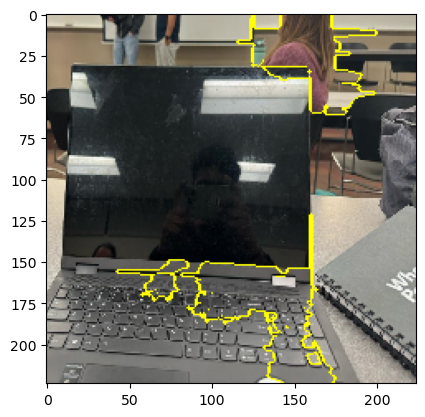

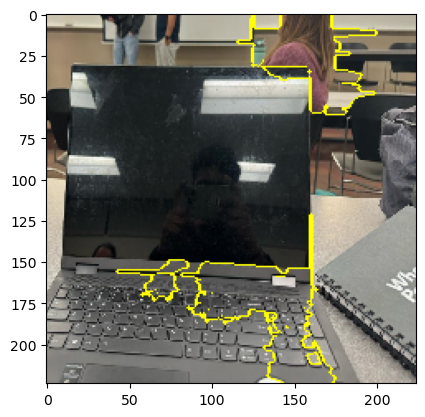

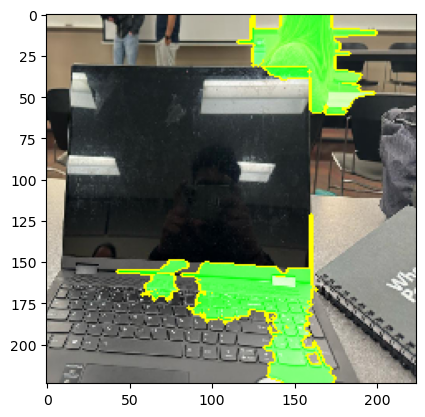

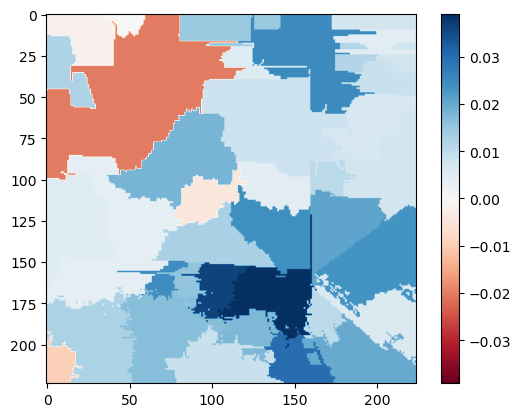

  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 741ms/step
[745, 778, 786, 843, 743]


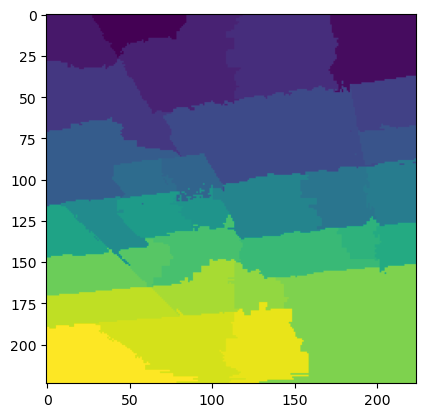

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(224, 224, 3) (224, 224)


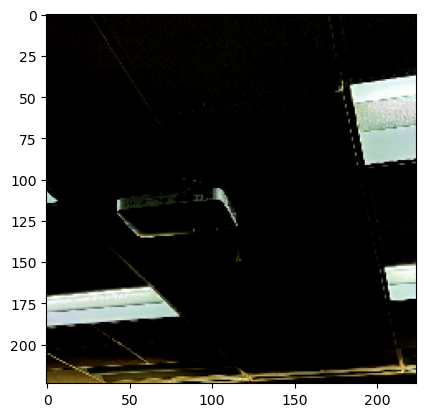

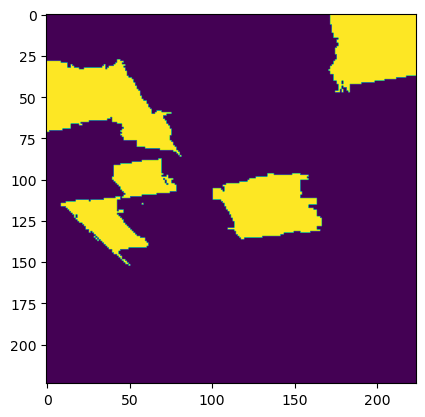

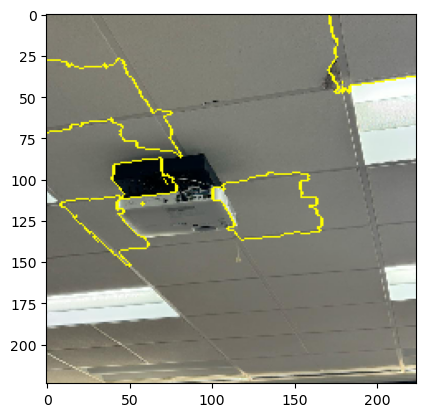

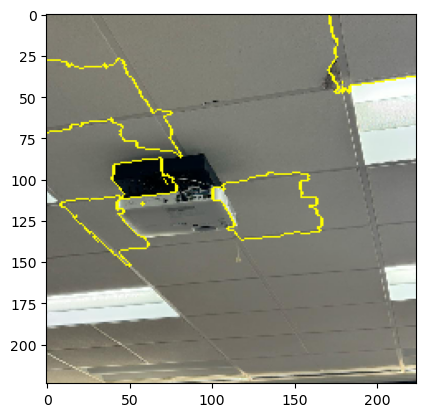

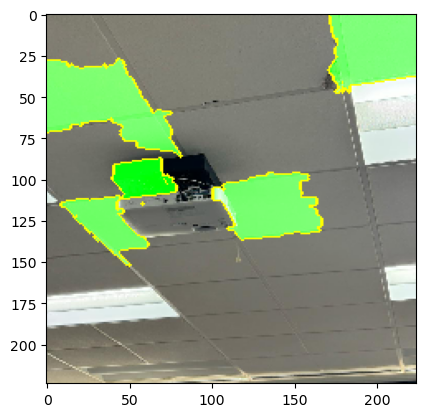

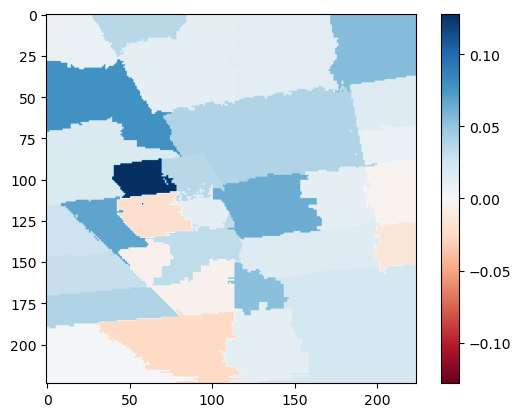

Wall time: 5min 56s


In [10]:
%%time
labels = []
from skimage.segmentation import mark_boundaries
 
for image_name, x in processed_images_for_Lime.items():
    explanation = explainer.explain_instance(x[0].astype('double'), inet_model.predict, top_labels = 5, hide_color = 0, num_samples = 500)
    print(explanation.top_labels)
    plt.imshow(explanation.segments)
    plt.show()
    label = explanation.top_labels[0]
    labels.append(label)
    
    a = explanation.get_image_and_mask(label=label)
    print(a[0].shape, a[1].shape)
    plt.imshow(a[0])
    plt.show()
    plt.imshow(a[1])
    plt.show()
    
    output_image = a[0]
    output_mask = a[1]
    plt.imshow(mark_boundaries(output_image/2+0.5, output_mask))
    plt.show()
    
    temp, mask = explanation.get_image_and_mask(label, positive_only =True, num_features =5, hide_rest = False)
    plt.imshow(mark_boundaries(temp/2+0.5, mask))
    plt.show()
    
    temp, mask = explanation.get_image_and_mask(label, positive_only =False, num_features =5, hide_rest = False)
    plt.imshow(mark_boundaries(temp/2+0.5, mask))
    plt.show()
    
    ind = label

    dict_heatmap =dict(explanation.local_exp[ind])
    heatmap = np.vectorize(dict_heatmap.get)(explanation.segments)

    # plotting the visualiazation
    plt.imshow(heatmap,cmap ="RdBu", vmin = -heatmap.max(), vmax = heatmap.max())
    plt.colorbar()
    plt.show()

<br></br>
<h2>Result 3</h2>

**Discussion:** 

1) Water Bottle: For the 100 samples the border mask/explanation focusing on some part of the bottle(such as cap, upper bottle/at the neck) thinking that could be the major region to predict that its a bottle and it also focusing more outside the bottle area which doesn't make much sense.
For the 500 samples, It focuses mostly on bottle almost covering entire region(such as neck, cap, and this time the bottom of the bottle too) which adds more features which are critical for the model to predict and to increase the confidence.

2) Dining Table: For 100 samples, the main contributing features are some part of chair, window, table and the most part of the carpet. Even though it is not a dining table, the window, table and carpet are playing crucial role in this prediction.
For 500 samples, Some part of chair and focusing more on carpet, and table which adds more strength to the explanation given.

3) Chair: For 100 samples, the model focusing on some part of upper part and sitting part and some legs to explain that it is a folding chair.
For 500 samples, It is mostly focusing on lower part to explain that it is a folding chair.

4) Analog clock: For 100 samples the model explaining and giving top prediction as analog clock based on number '3', the dail of a clock and the wall behind it. 
For 500 samples, it is adding more features of the clock and other digits in the clock adding strength to the explanation.

5) Electric fan: For 100 samples, the ceiling adding more value in predicting that it is a fan than the wings other parts of fan. 
But for in 500 samples, most of the fan and the ceiling contributing in predicting that it is a electric fan.

6) Laptop: for 100 and 500 samples it is not varying that much.. it is mostly explaining that because of keyboard, hinges and some part of display pushing the model in predicitng that it is a laptop.

7) Projector: For this one too it is not varying that much for 100 and 500 samples, the ceiling and the black part of projector contributing in the prediction.

<br></br>
<h1>Trying other models</h1>

**Xception model:** This is an extension of inception architecture which replaces the standard inception modules with depthwise separable convolutions. Depthwise separable convolutions reduce the number of parameters and computational complexity, making the network more efficient without a significant loss in performance. By decoupling the spatial and depth (channel) dimensions, depthwise separable convolutions allow the network to more flexibly adapt to features in the input data.

In [11]:
from keras.applications.xception import Xception, preprocess_input, decode_predictions

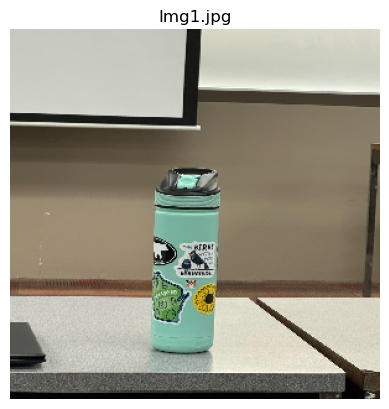

1/1 [==============================] - 2s 2s/step
Top 5 predictions:
1: home_theater with confidence 0.32
2: television with confidence 0.06
3: monitor with confidence 0.04
4: desktop_computer with confidence 0.03
5: ashcan with confidence 0.02




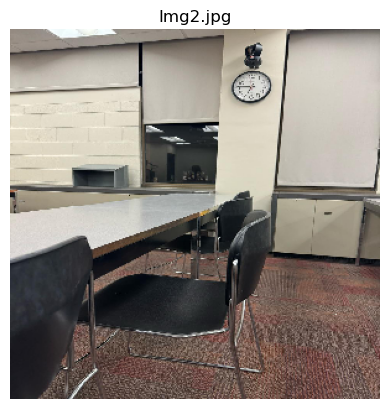

1/1 [==============================] - 0s 332ms/step
Top 5 predictions:
1: dining_table with confidence 0.31
2: wall_clock with confidence 0.10
3: desk with confidence 0.08
4: folding_chair with confidence 0.05
5: ping-pong_ball with confidence 0.03




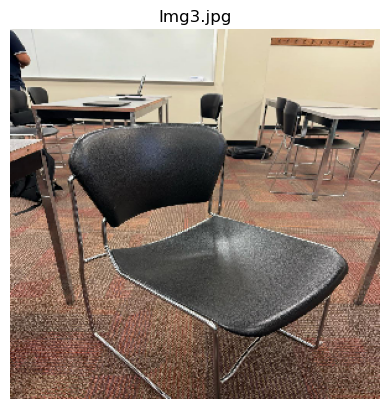

1/1 [==============================] - 0s 332ms/step
Top 5 predictions:
1: folding_chair with confidence 0.83
2: dining_table with confidence 0.02
3: barber_chair with confidence 0.01
4: rocking_chair with confidence 0.01
5: desk with confidence 0.01




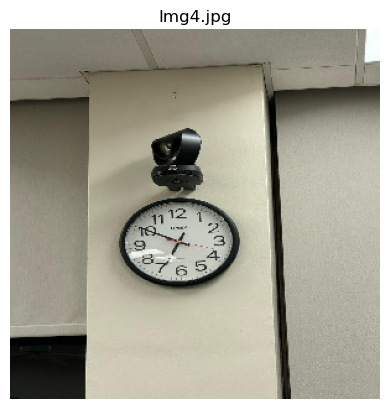

1/1 [==============================] - 0s 316ms/step
Top 5 predictions:
1: analog_clock with confidence 0.46
2: wall_clock with confidence 0.19
3: stopwatch with confidence 0.08
4: stethoscope with confidence 0.00
5: barometer with confidence 0.00




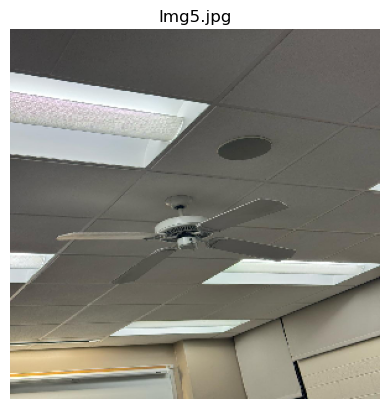

1/1 [==============================] - 0s 343ms/step
Top 5 predictions:
1: electric_fan with confidence 0.44
2: warplane with confidence 0.06
3: airship with confidence 0.03
4: projector with confidence 0.03
5: cinema with confidence 0.02




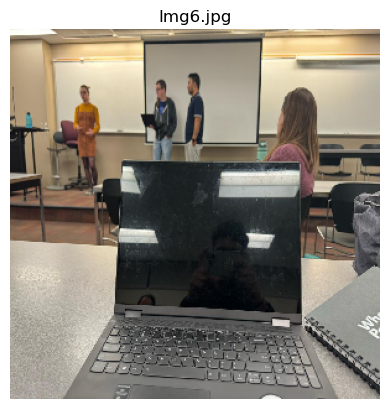

1/1 [==============================] - 0s 316ms/step
Top 5 predictions:
1: laptop with confidence 0.46
2: notebook with confidence 0.33
3: mouse with confidence 0.01
4: desk with confidence 0.01
5: printer with confidence 0.01




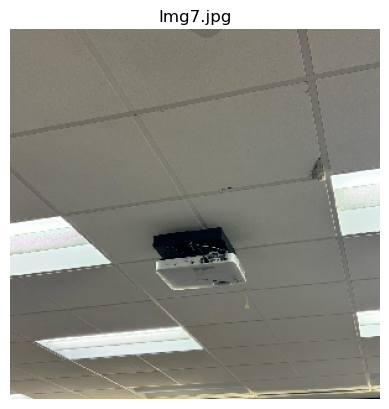

1/1 [==============================] - 0s 321ms/step
Top 5 predictions:
1: projector with confidence 0.40
2: spotlight with confidence 0.06
3: photocopier with confidence 0.04
4: solar_dish with confidence 0.02
5: carton with confidence 0.02




In [12]:
xception_model = Xception()

for image_name, img in sorted(images_dict.items()):
#     img_path = os.path.join(image_dir, img_name)
#     img = load_img(img_path, target_size=(299, 299)) Xception also expects images of size 299*299
    plt.imshow(img)
    plt.title(image_name)
    plt.axis('off')  
    plt.show()
    
    x = img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)
    
    preds = xception_model.predict(x)
    
    decoded_preds = decode_predictions(preds, top=5)[0]
    
    print(f"Top 5 predictions:")
    for i, (imagenet_id, name, score) in enumerate(decoded_preds):
        print(f"{i+1}: {name} with confidence {score:.2f}")
    print("\n")


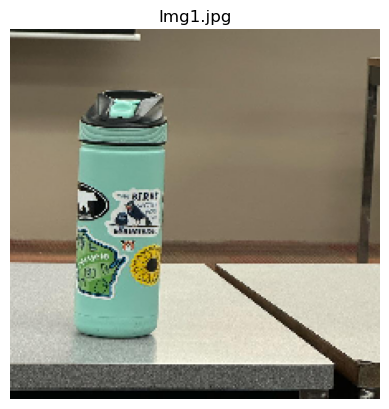

1/1 [==============================] - 0s 223ms/step
Top 5 predictions:
1: water_bottle with confidence 0.70
2: ashcan with confidence 0.20
3: can_opener with confidence 0.05
4: lighter with confidence 0.01
5: pop_bottle with confidence 0.01




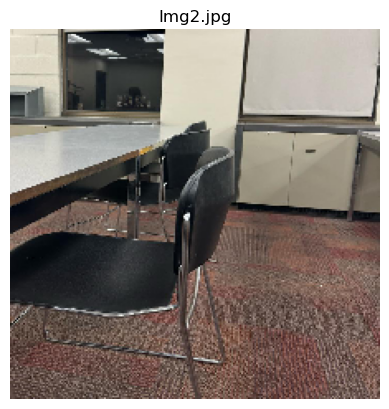

1/1 [==============================] - 0s 217ms/step
Top 5 predictions:
1: dining_table with confidence 0.39
2: grand_piano with confidence 0.15
3: folding_chair with confidence 0.12
4: desk with confidence 0.12
5: file with confidence 0.03




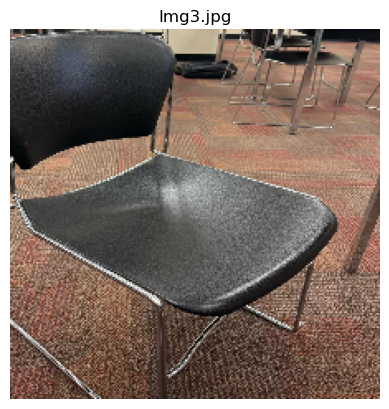

1/1 [==============================] - 0s 222ms/step
Top 5 predictions:
1: folding_chair with confidence 0.88
2: barber_chair with confidence 0.06
3: rocking_chair with confidence 0.03
4: patio with confidence 0.01
5: dining_table with confidence 0.01




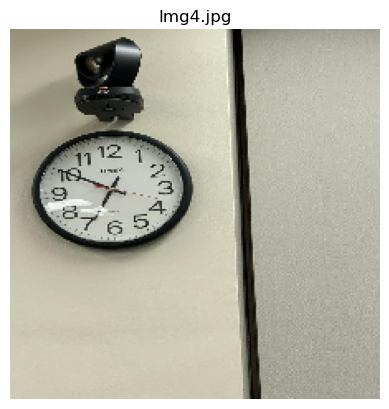

1/1 [==============================] - 0s 204ms/step
Top 5 predictions:
1: stopwatch with confidence 0.56
2: analog_clock with confidence 0.40
3: wall_clock with confidence 0.03
4: stethoscope with confidence 0.00
5: barometer with confidence 0.00




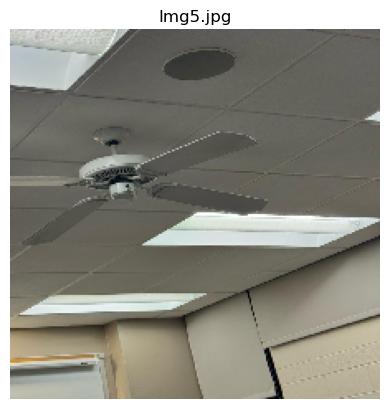

1/1 [==============================] - 0s 230ms/step
Top 5 predictions:
1: wing with confidence 0.21
2: warplane with confidence 0.17
3: projectile with confidence 0.09
4: missile with confidence 0.06
5: carton with confidence 0.03




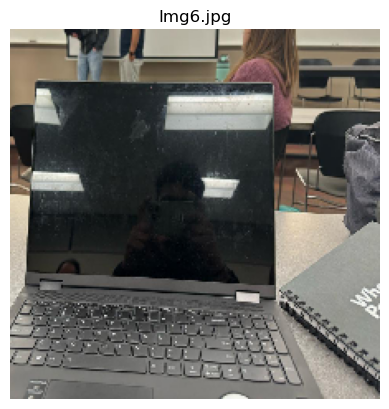

1/1 [==============================] - 0s 198ms/step
Top 5 predictions:
1: laptop with confidence 0.66
2: notebook with confidence 0.33
3: mouse with confidence 0.00
4: desk with confidence 0.00
5: computer_keyboard with confidence 0.00




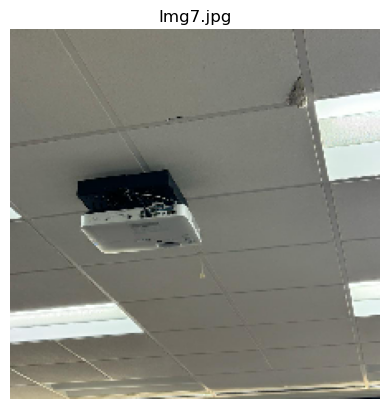

1/1 [==============================] - 0s 217ms/step
Top 5 predictions:
1: projector with confidence 0.58
2: spotlight with confidence 0.06
3: photocopier with confidence 0.04
4: carton with confidence 0.02
5: solar_dish with confidence 0.02




In [16]:
processed_images_for_Lime = {}

for image_name, img in sorted(images_dict.items()):
    width, height = img.size
    cropped_img = img.crop((width/4, height/4, 4*width/4, 4*height/4))
    plt.imshow(cropped_img)
    plt.title(image_name)
    plt.axis('off')
    plt.show()

    x = img_to_array(cropped_img)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)
    
    preds = xception_model.predict(x)

    decoded_preds = decode_predictions(preds, top=5)[0]
    
    print(f"Top 5 predictions:")
    for i, (imagenet_id, name, score) in enumerate(decoded_preds):
        print(f"{i+1}: {name} with confidence {score:.2f}")
    print("\n")
    processed_images_for_Lime[image_name] = x

  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 1s/step
[898, 412, 473, 626, 737]


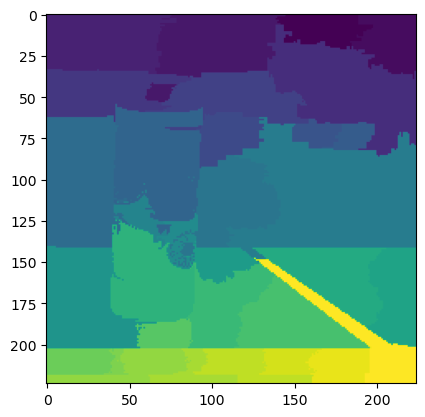

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(224, 224, 3) (224, 224)


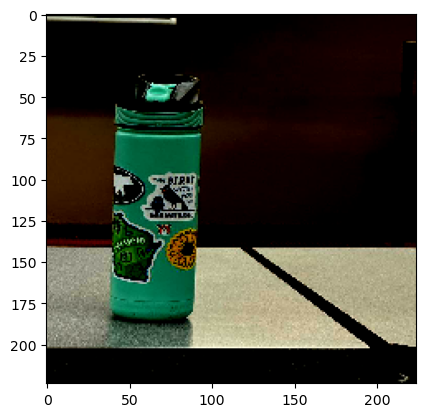

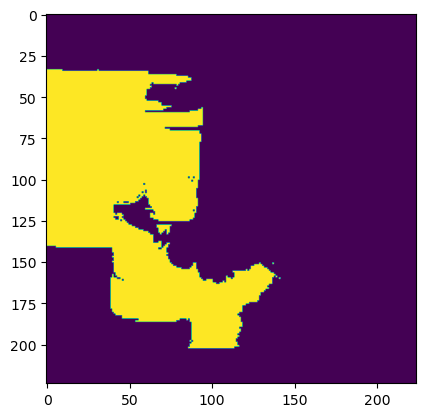

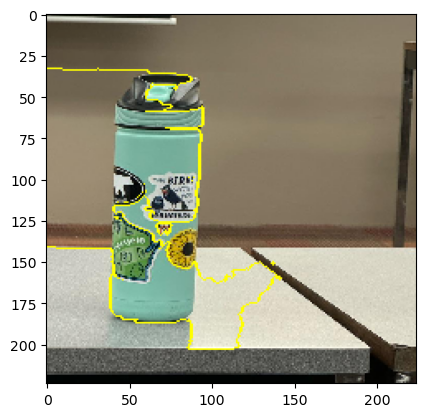

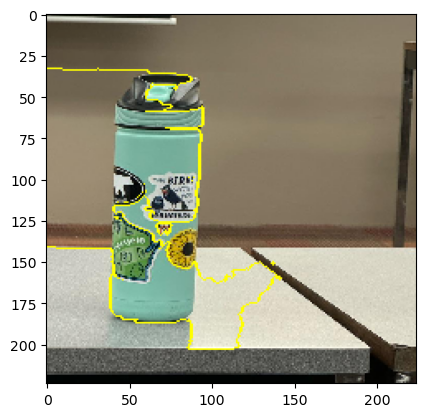

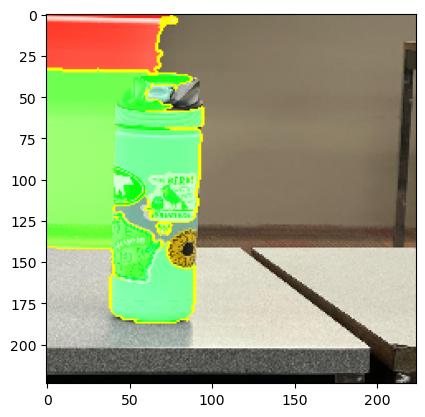

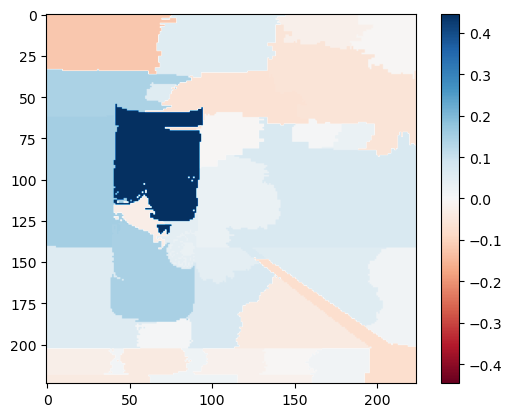

  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 1s/step
[532, 579, 559, 526, 553]


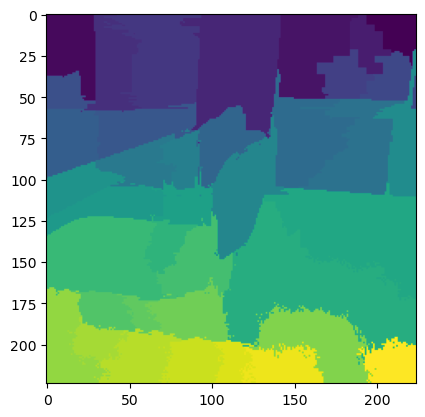

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(224, 224, 3) (224, 224)


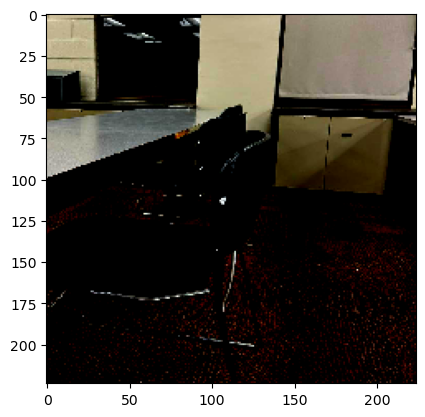

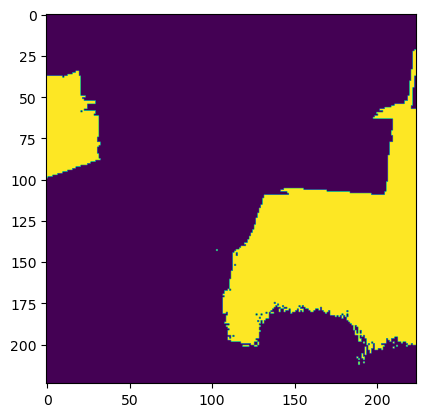

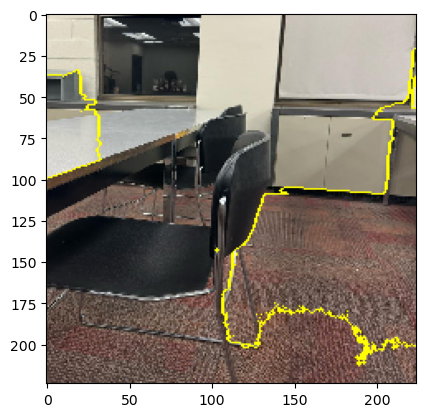

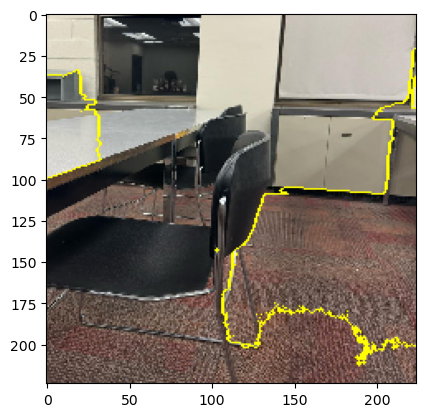

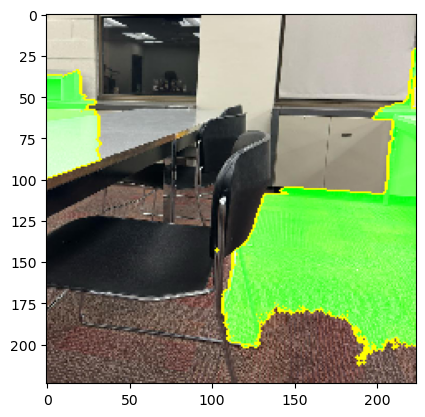

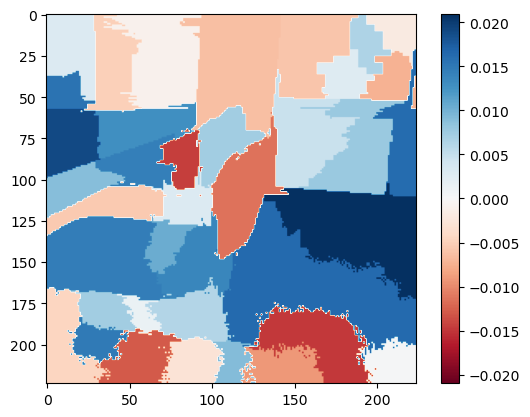

  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 1s/step
[559, 423, 765, 706, 532]


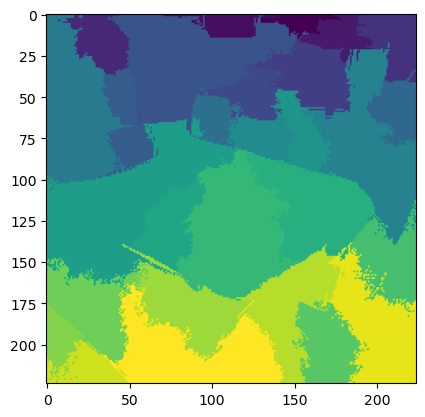

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(224, 224, 3) (224, 224)


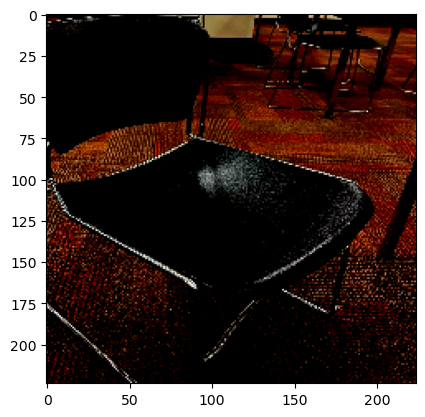

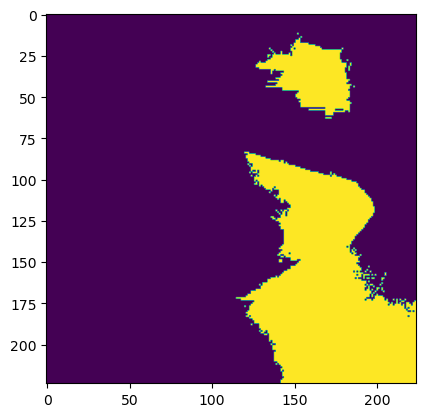

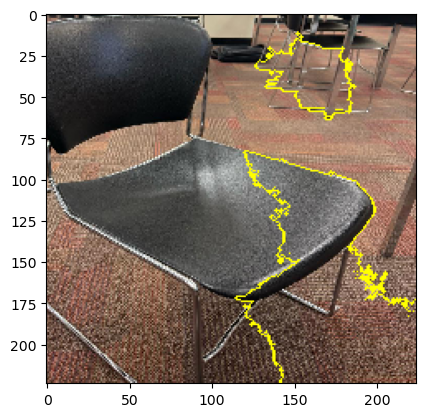

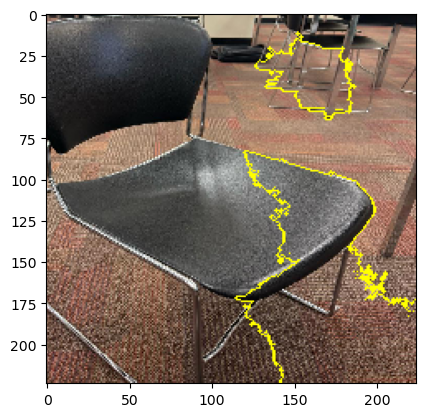

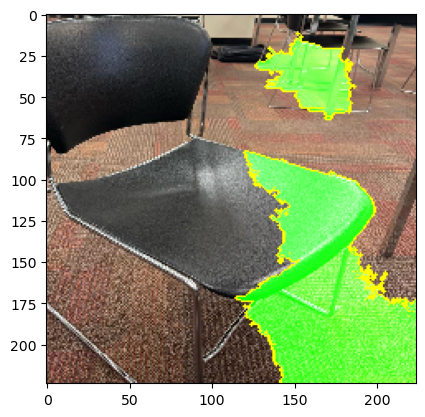

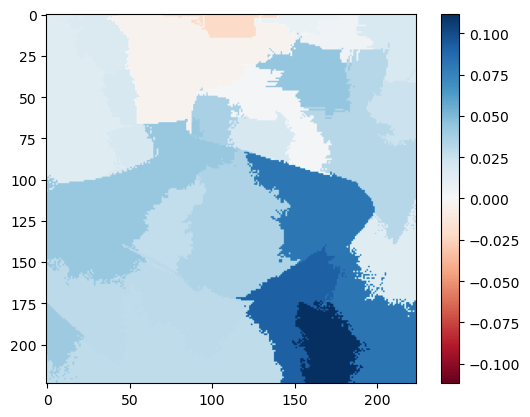

  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 1s/step
[826, 409, 892, 823, 426]


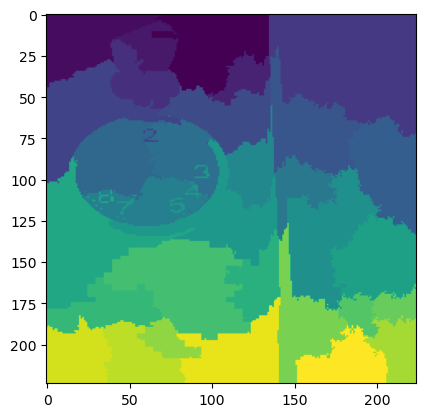

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(224, 224, 3) (224, 224)


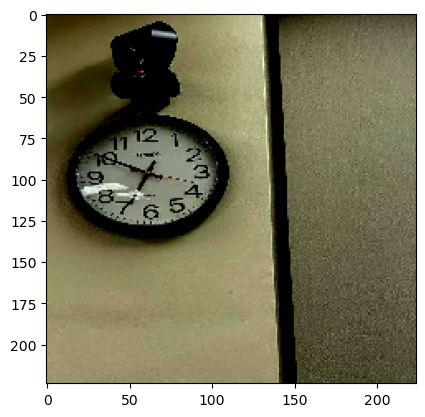

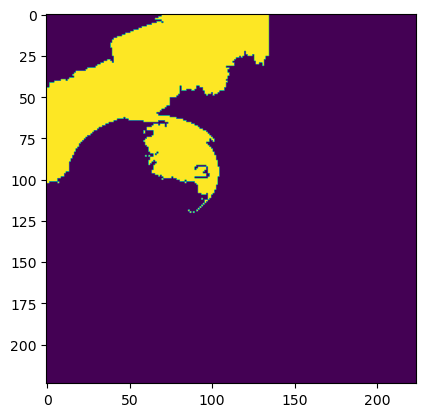

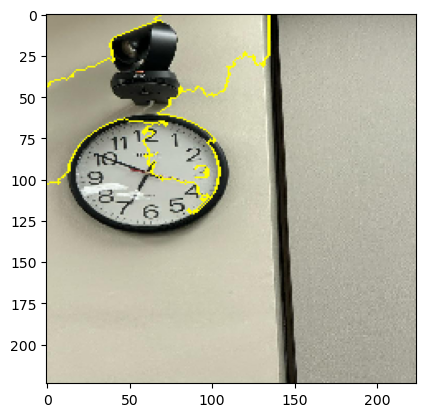

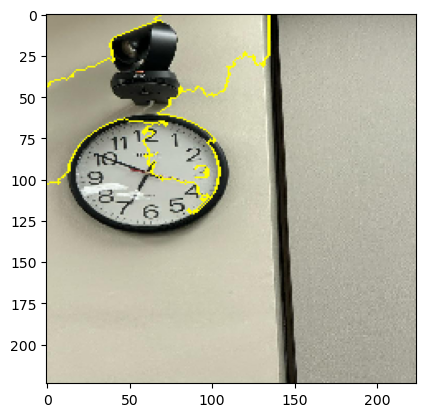

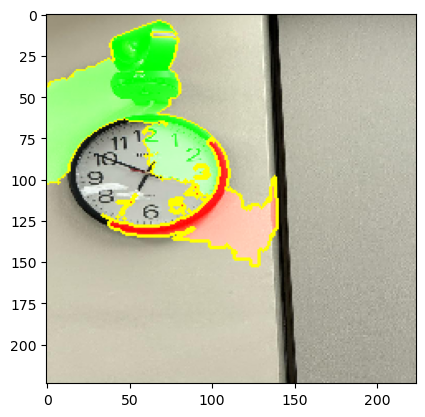

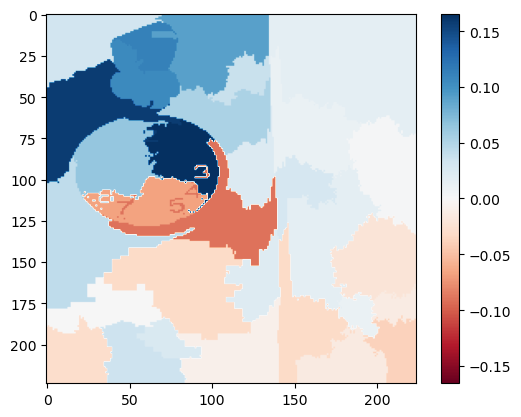

  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 1s/step
[908, 895, 744, 657, 478]


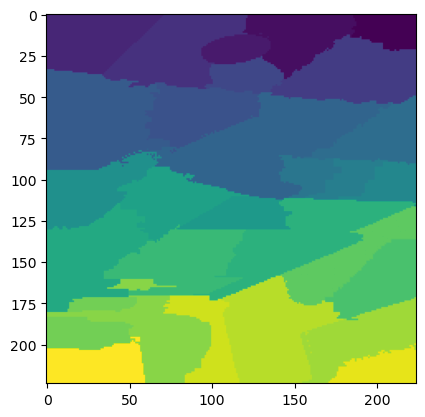

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(224, 224, 3) (224, 224)


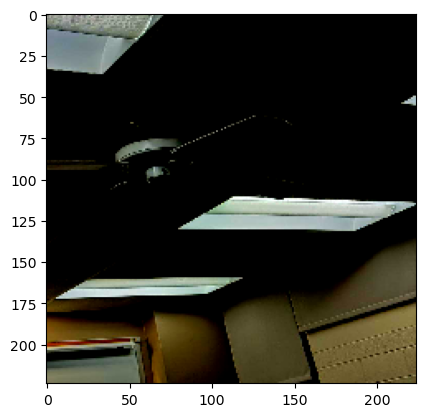

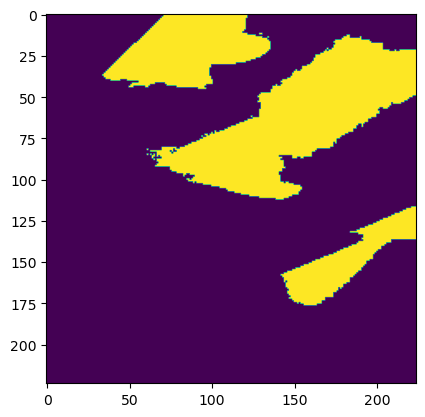

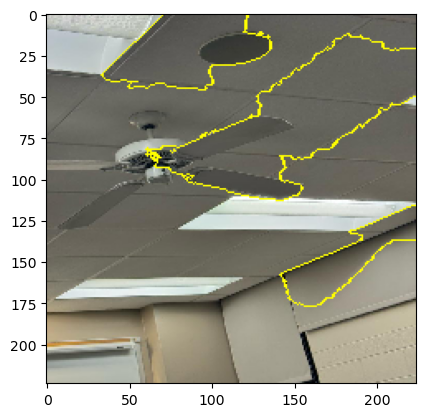

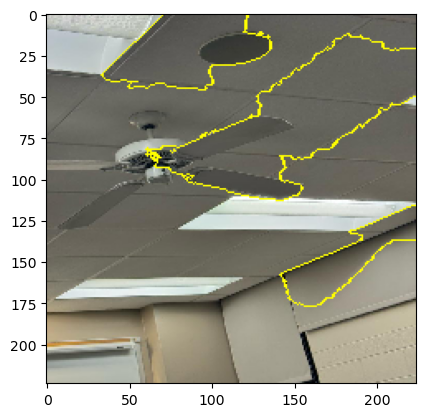

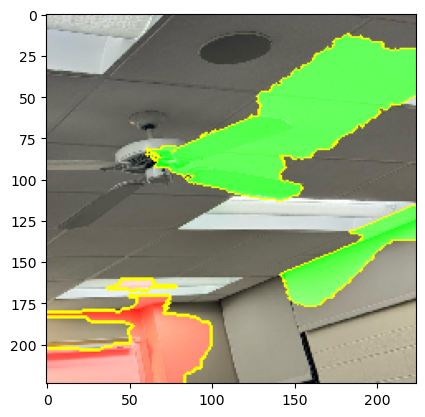

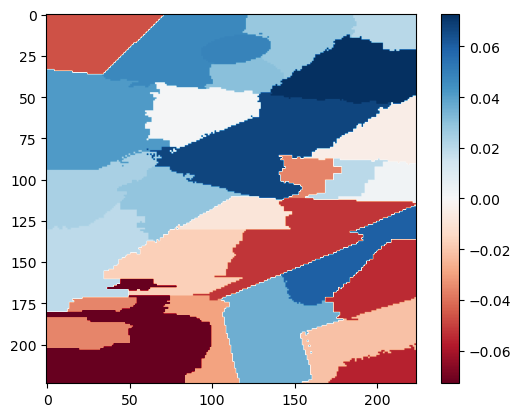

  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 1s/step
[620, 681, 673, 526, 508]


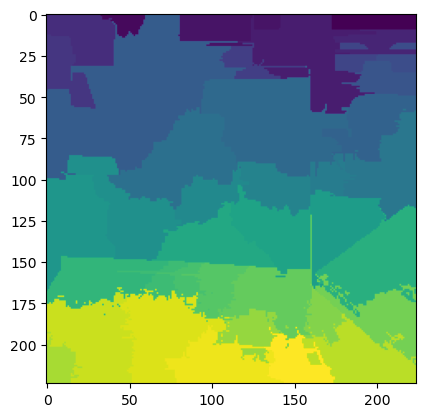

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(224, 224, 3) (224, 224)


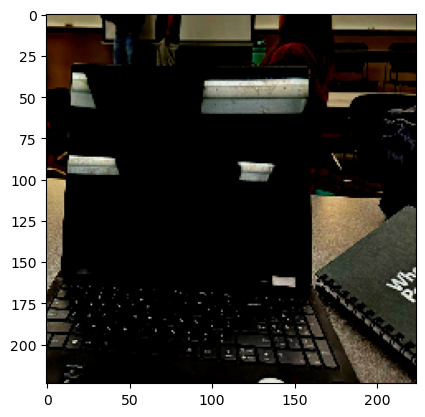

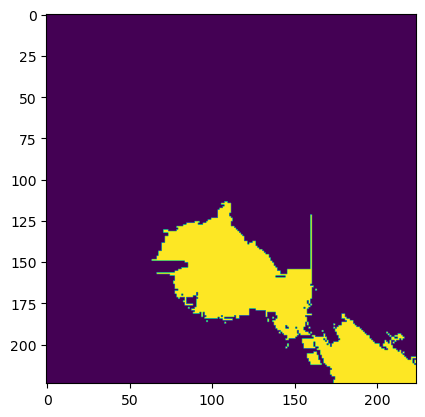

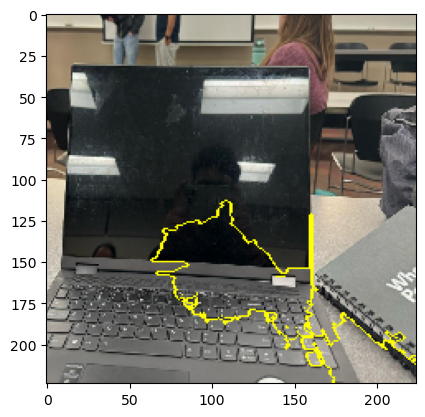

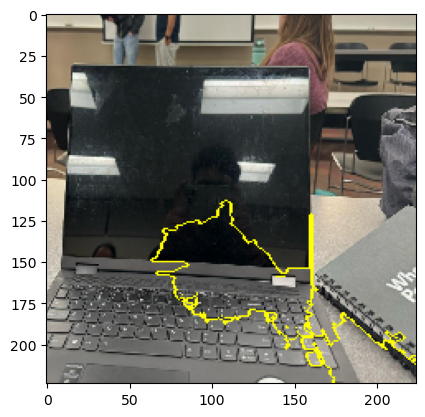

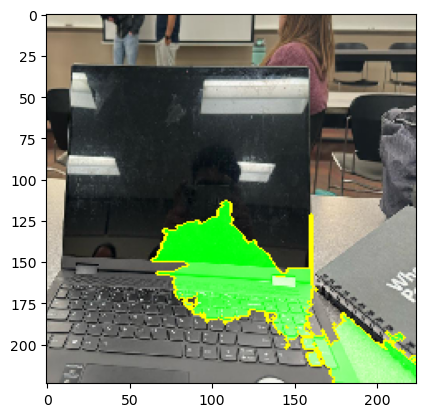

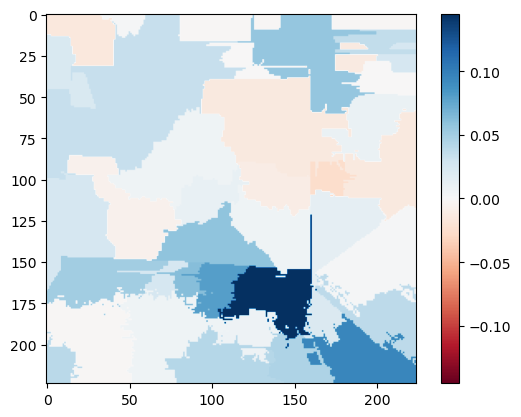

  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 1s/step
[745, 818, 713, 478, 807]


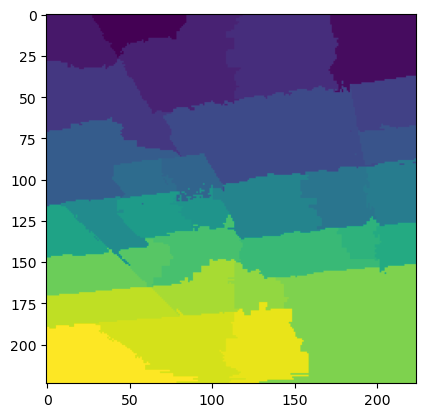

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(224, 224, 3) (224, 224)


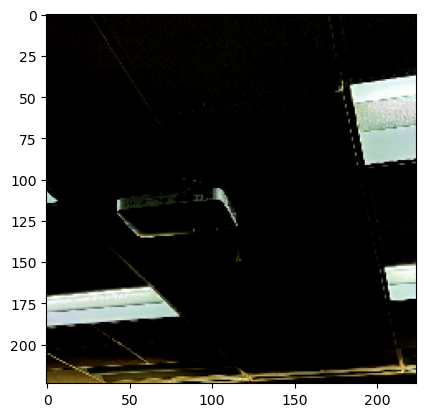

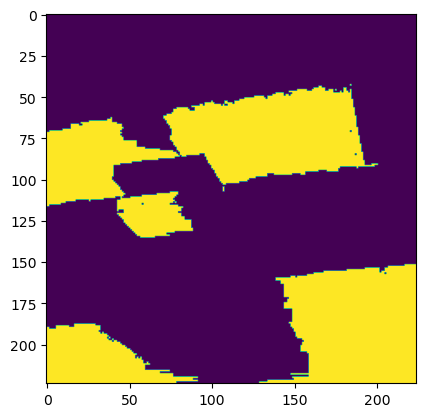

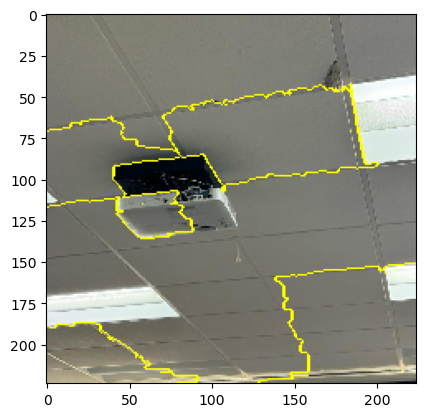

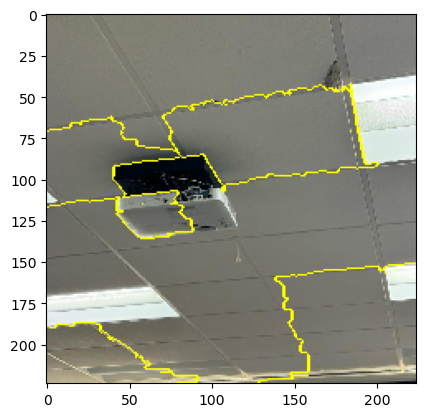

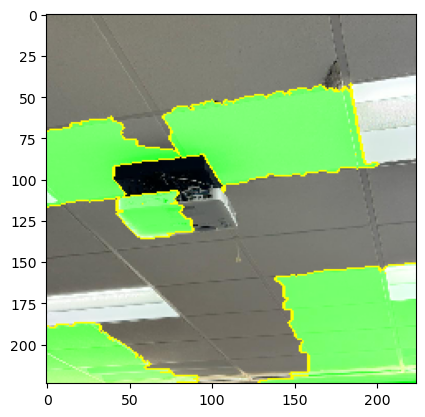

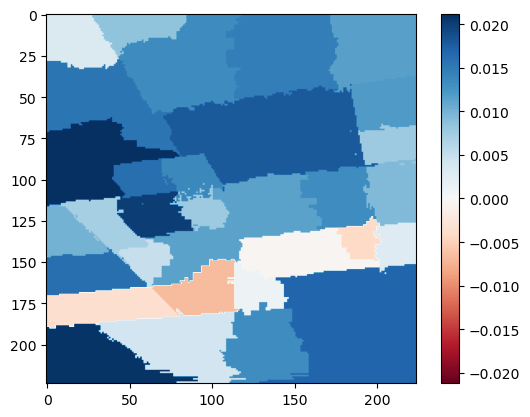

Wall time: 20min 45s


In [25]:
%%time
from skimage.segmentation import mark_boundaries
 
for image_name, x in processed_images_for_Lime.items():
    explanation = explainer.explain_instance(x[0].astype('double'), xception_model.predict, top_labels = 5, hide_color = 0, num_samples = 500)
    print(explanation.top_labels)
    plt.imshow(explanation.segments)
    plt.show()
    label = explanation.top_labels[0]
    
    a = explanation.get_image_and_mask(label=label)
    print(a[0].shape, a[1].shape)
    plt.imshow(a[0])
    plt.show()
    plt.imshow(a[1])
    plt.show()
    
    output_image = a[0]
    output_mask = a[1]
    plt.imshow(mark_boundaries(output_image/2+0.5, output_mask))
    plt.show()
    
    temp, mask = explanation.get_image_and_mask(label, positive_only =True, num_features =5, hide_rest = False)
    plt.imshow(mark_boundaries(temp/2+0.5, mask))
    plt.show()
    
    temp, mask = explanation.get_image_and_mask(label, positive_only =False, num_features =5, hide_rest = False)
    plt.imshow(mark_boundaries(temp/2+0.5, mask))
    plt.show()
    
    ind = label

    dict_heatmap =dict(explanation.local_exp[ind])
    heatmap = np.vectorize(dict_heatmap.get)(explanation.segments)

    # plotting the visualiazation
    plt.imshow(heatmap,cmap ="RdBu", vmin = -heatmap.max(), vmax = heatmap.max())
    plt.colorbar()
    plt.show()

<br></br>
<h2>Result 4</h2>

**Discussion:** <h4>Inception V3 vs Xception</h4>

The two models predictions are varying across images: (After cropping)

1) Water Bottle: The confidence of water bottle is 100% for the InceptionV3 model but it is 70% for the Xception. New predictions also entered into top 5 in the Xception model, such as "ashcan", "pop bottle", and "can opener"

2) Table & Chair: The Confidence seen a drastic decrease from 90 to 39, and new prediction also came into picture which is file with confidence of 0.03.

3) Chair: The folding chair still holds the top position in the prediction with little vary in the confidence, Barber chair gained some points from 0 to 0.06.

4) Analog clock: In Xception the stop watch raced to top spot beating analog and pushed analog to second spot.

5) Electric Fan: The predictions have completely changed, Electric fan is not even in the top 5 list for Xception model.

6) Laptop: Laptop hold the top spot in both the models with some varience in confidence.

7) Projector: Confidences are dropped a little bit but still holds the top spot. However some new predictions replaced some of the predictions of InceptionV3, such as Solar dish.

In the context of explanations: If you can see the Xception taking the top area which is top outside region of bottle as negative feature which means completely neglecting the region and not considering that to predict.

In [20]:
from keras.applications.vgg16 import VGG16, decode_predictions

(224, 224)


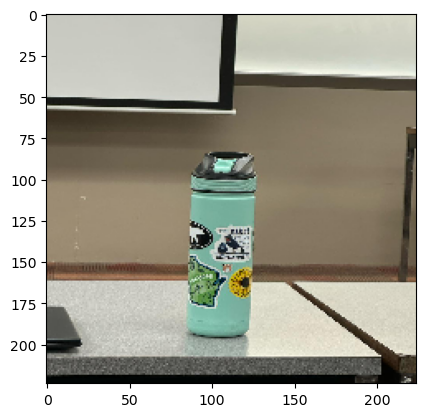

(224, 224)


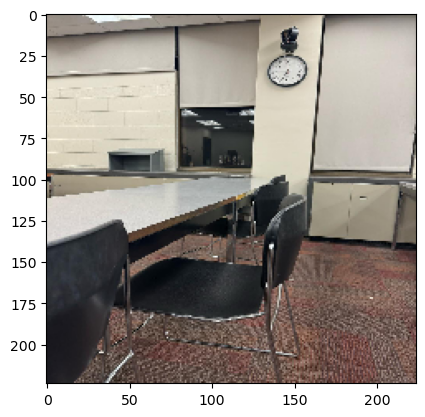

(224, 224)


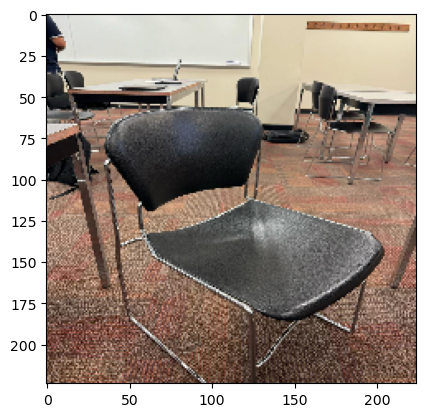

(224, 224)


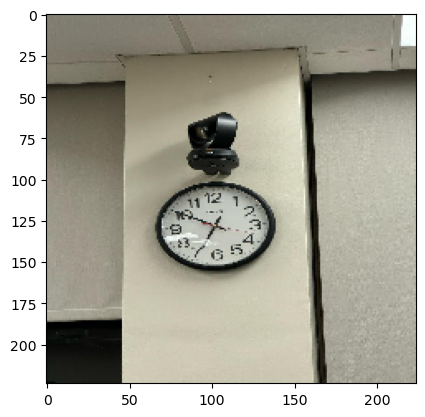

(224, 224)


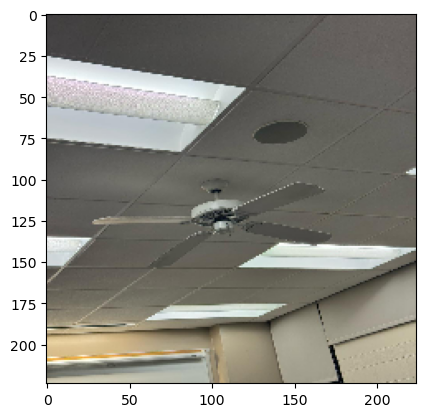

(224, 224)


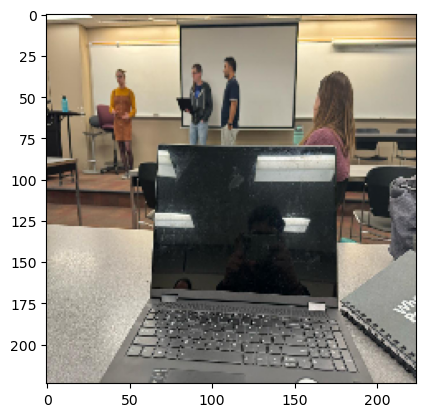

(224, 224)


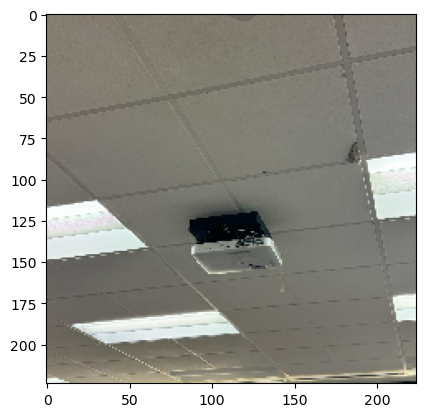

In [21]:
vgg_model = VGG16()

images_dict_vgg = {}
for img_name in os.listdir(image_dir):
    img_path = os.path.join(image_dir, img_name)
    img = load_img(img_path, target_size=(224, 224)) #vgg16 expects images of size 224*224
    images_dict_vgg[img_name] = img
    print(img.size)
    plt.imshow(img)
    plt.show()

(224, 224)


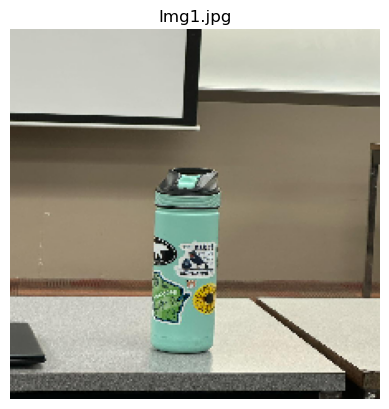

1/1 [==============================] - 1s 649ms/step
Top 5 predictions:
1: water_bottle with confidence 0.12
2: ashcan with confidence 0.11
3: home_theater with confidence 0.06
4: desk with confidence 0.06
5: swab with confidence 0.05


(224, 224)


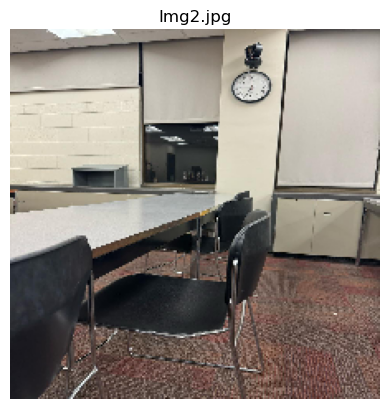

1/1 [==============================] - 0s 355ms/step
Top 5 predictions:
1: barrow with confidence 0.26
2: folding_chair with confidence 0.08
3: Dutch_oven with confidence 0.05
4: caldron with confidence 0.05
5: grand_piano with confidence 0.04


(224, 224)


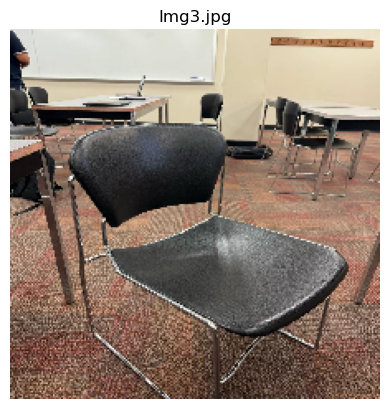

1/1 [==============================] - 0s 359ms/step
Top 5 predictions:
1: folding_chair with confidence 0.54
2: patio with confidence 0.22
3: dining_table with confidence 0.04
4: studio_couch with confidence 0.03
5: laptop with confidence 0.02


(224, 224)


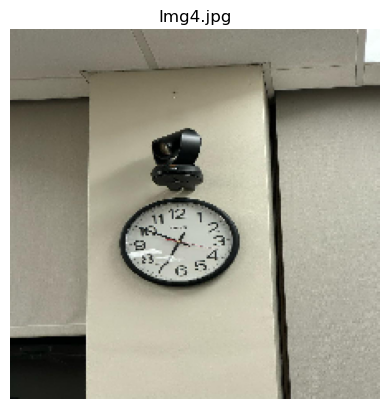

1/1 [==============================] - 0s 348ms/step
Top 5 predictions:
1: stopwatch with confidence 0.51
2: wall_clock with confidence 0.23
3: analog_clock with confidence 0.15
4: barometer with confidence 0.07
5: magnetic_compass with confidence 0.02


(224, 224)


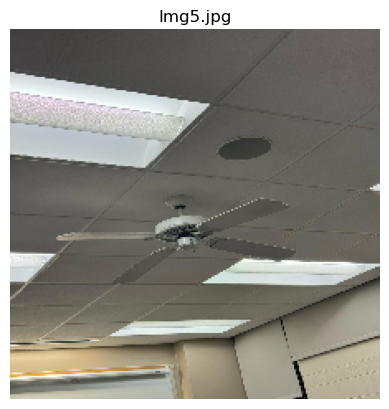

1/1 [==============================] - 0s 348ms/step
Top 5 predictions:
1: wing with confidence 0.29
2: warplane with confidence 0.21
3: missile with confidence 0.06
4: aircraft_carrier with confidence 0.05
5: projectile with confidence 0.04


(224, 224)


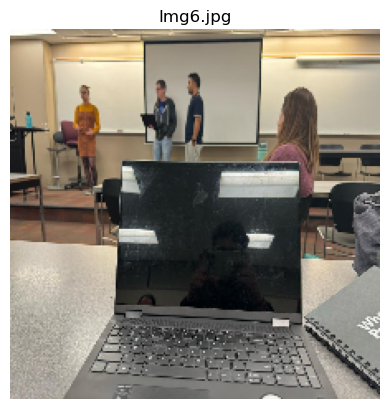

1/1 [==============================] - 0s 339ms/step
Top 5 predictions:
1: laptop with confidence 0.76
2: notebook with confidence 0.15
3: space_bar with confidence 0.02
4: printer with confidence 0.02
5: desktop_computer with confidence 0.01


(224, 224)


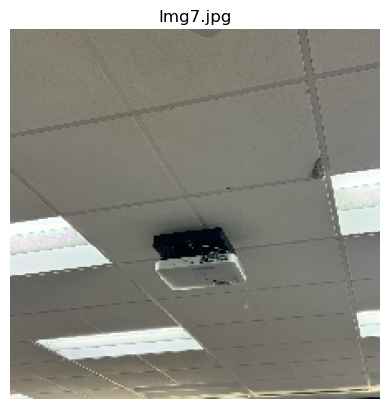

1/1 [==============================] - 0s 333ms/step
Top 5 predictions:
1: warplane with confidence 0.09
2: wing with confidence 0.09
3: carton with confidence 0.08
4: airship with confidence 0.08
5: projector with confidence 0.06




In [22]:
from tensorflow.keras.applications.vgg16 import preprocess_input
for image_name, img in sorted(images_dict_vgg.items()):
    print(img.size)
    plt.imshow(img)
    plt.title(image_name)
    plt.axis('off')  
    plt.show()
    
    x = img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)
    
    preds = vgg_model.predict(x)
    
    decoded_preds = decode_predictions(preds, top=5)[0]
    
    print(f"Top 5 predictions:")
    for i, (imagenet_id, name, score) in enumerate(decoded_preds):
        print(f"{i+1}: {name} with confidence {score:.2f}")
    print("\n")

224 224


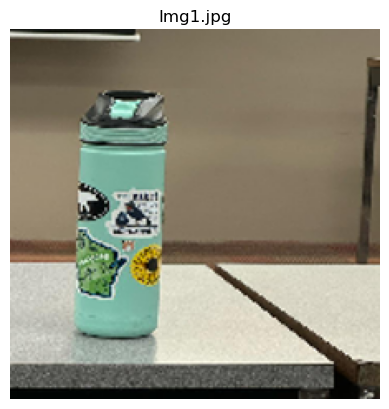

1/1 [==============================] - 0s 469ms/step
Top 5 predictions:
1: water_bottle with confidence 0.13
2: pencil_sharpener with confidence 0.08
3: ashcan with confidence 0.06
4: kimono with confidence 0.04
5: milk_can with confidence 0.04


224 224


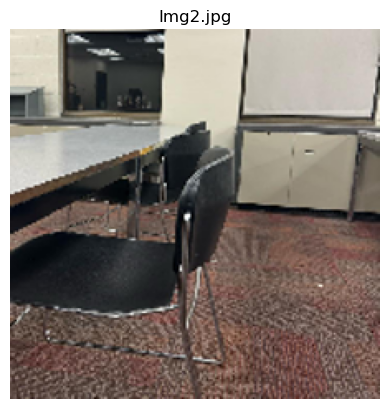

1/1 [==============================] - 0s 330ms/step
Top 5 predictions:
1: barrow with confidence 0.12
2: barber_chair with confidence 0.06
3: folding_chair with confidence 0.04
4: lumbermill with confidence 0.03
5: grand_piano with confidence 0.03


224 224


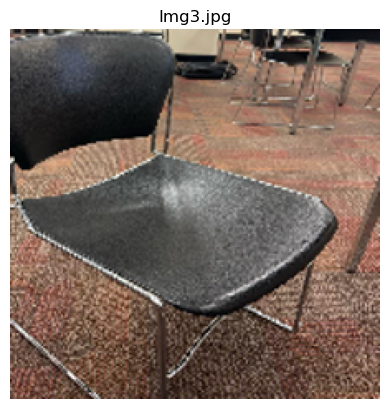

1/1 [==============================] - 0s 354ms/step
Top 5 predictions:
1: folding_chair with confidence 0.25
2: dining_table with confidence 0.11
3: patio with confidence 0.10
4: barrow with confidence 0.05
5: studio_couch with confidence 0.04


224 224


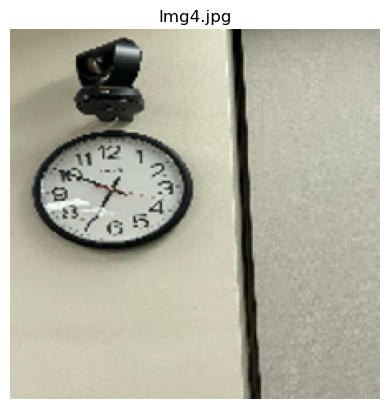

1/1 [==============================] - 0s 366ms/step
Top 5 predictions:
1: stopwatch with confidence 0.70
2: analog_clock with confidence 0.12
3: wall_clock with confidence 0.11
4: barometer with confidence 0.02
5: magnetic_compass with confidence 0.01


224 224


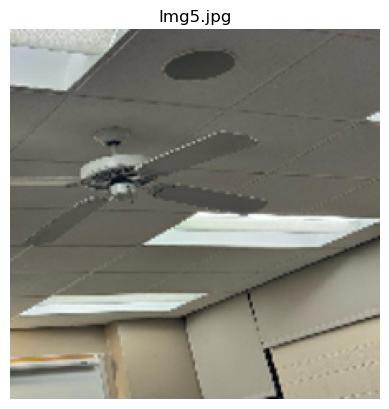

1/1 [==============================] - 0s 324ms/step
Top 5 predictions:
1: warplane with confidence 0.24
2: aircraft_carrier with confidence 0.12
3: wing with confidence 0.11
4: missile with confidence 0.03
5: airship with confidence 0.02


224 224


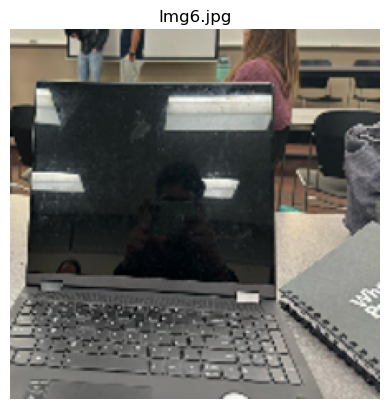

1/1 [==============================] - 0s 349ms/step
Top 5 predictions:
1: laptop with confidence 0.64
2: notebook with confidence 0.29
3: computer_keyboard with confidence 0.01
4: space_bar with confidence 0.01
5: desktop_computer with confidence 0.01


224 224


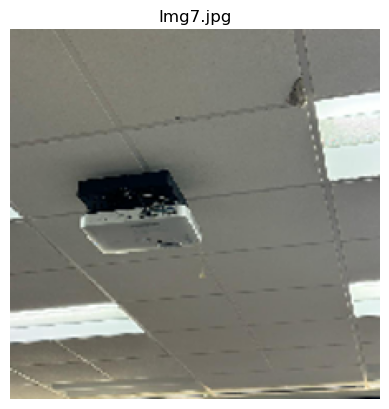

1/1 [==============================] - 0s 350ms/step
Top 5 predictions:
1: warplane with confidence 0.17
2: wing with confidence 0.13
3: aircraft_carrier with confidence 0.08
4: submarine with confidence 0.07
5: projector with confidence 0.05




In [23]:
processed_images_for_Lime_vgg = {}

for image_name, img in sorted(images_dict_vgg.items()):
    width, height = img.size
    print(width, height)
    cropped_img = img.crop((width/4, height/4, 4*width/4, 4*height/4)).resize((224, 224))
    plt.imshow(cropped_img)
    plt.title(image_name)
    plt.axis('off')
    plt.show()

    x = img_to_array(cropped_img)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)
    
    preds = vgg_model.predict(x)

    decoded_preds = decode_predictions(preds, top=5)[0]
    
    print(f"Top 5 predictions:")
    for i, (imagenet_id, name, score) in enumerate(decoded_preds):
        print(f"{i+1}: {name} with confidence {score:.2f}")
    print("\n")
    processed_images_for_Lime_vgg[image_name] = x

In [26]:
# %%time
# from skimage.segmentation import mark_boundaries
 
# for image_name, x in processed_images_for_Lime_vgg.items():
#     explanation = explainer.explain_instance(x[0].astype('double'), vgg_model.predict, top_labels = 5, hide_color = 0, num_samples = 500)
#     print(explanation.top_labels)
#     plt.imshow(explanation.segments)
#     plt.show()
#     label = explanation.top_labels[0]
    
#     a = explanation.get_image_and_mask(label=label)
#     print(a[0].shape, a[1].shape)
#     plt.imshow(a[0])
#     plt.show()
#     plt.imshow(a[1])
#     plt.show()
    
#     output_image = a[0]
#     output_mask = a[1]
#     plt.imshow(mark_boundaries(output_image/2+0.5, output_mask))
#     plt.show()
    
#     temp, mask = explanation.get_image_and_mask(label, positive_only =True, num_features =5, hide_rest = False)
#     plt.imshow(mark_boundaries(temp/2+0.5, mask))
#     plt.show()
    
#     temp, mask = explanation.get_image_and_mask(label, positive_only =False, num_features =5, hide_rest = False)
#     plt.imshow(mark_boundaries(temp/2+0.5, mask))
#     plt.show()

<br></br>
<h2>Result 4</h2>

<h2>Comparing VGG16 with other models</h2>

**Discussion:**

1) The top prediction for both water bottle and laptop are same as other models but huge change oin confidences. 

2) The predictions for rest of the images are completely changed with low confidences.

This drop in confidences and poor predictions are because of resizing the images again after cropping. VGG16 model requires resizing images again into 224 x 224 after cropping. Which making images to shrink/zoom.


**Reason:**


For the VGG16 model, every input image must be resized to 224x224 pixels. This requirement is due to the architecture of VGG16, which includes fully connected layers towards the end. Fully connected layers have a fixed number of neurons, and thus, they require a fixed size of the input tensor.
<br>

On the other hand, the InceptionV3 model and Xception model, which is designed with a more flexible architecture, does not strictly require the input images to be of a fixed size. Although InceptionV3 recommends an input size of 299x299 pixels for optimal performance, it can accommodate slightly different sizes due to its use of global average pooling layers towards the end.

**Explnations of Vgg_model:** The plots of border masking are detoriating/giving different colors on the image and I don't know why. Did not understand what making them like this.

<br></br>
<h2>Result 5</h2>

For all the images heat maps are actually making sense even to the real world. The darkish blue tells us that region of the image contributing more in predicting the image and reddish shade telling us that the part of the region is not contributing much. 


The heatmaps generated using dict(explanation.local_exp[ind]) provide a visualization of these explanations, with the color intensity reflecting the weight or contribution of each segment to the prediction. The colors typically range from blue (positive influence) to red (negative influence).

In the real world, these heatmaps can make sense if the highlighted regions correspond to the distinctive features of the predicted class. For example, if the model predicts that an image contains a water bottle, we would expect the heatmap to highlight the bottle's shape, cap, label, or other recognizable features.